In [1]:
!pip install datasets
import nltk
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download("words")

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\urvas\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\urvas\AppData\Roaming\nltk_data...


True

In [227]:
import datasets
import pandas as pd
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import string
import numpy as np
import pandas as pd
import nltk
import string as s
import re
from nltk.corpus import stopwords
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from wordcloud import WordCloud
from nltk.stem import WordNetLemmatizer
from sklearn import preprocessing
from keras.utils import to_categorical
from sklearn.feature_extraction.text  import TfidfVectorizer
from sklearn.model_selection import train_test_split
import torch
import pandas as pd
from torch.utils.data import DataLoader, Dataset
from torch.nn.utils.rnn import pad_sequence
from torchtext import data
import spacy
from collections import defaultdict, Counter
from torchtext.legacy.data import Field, TabularDataset, LabelField, BucketIterator
from nltk.corpus import words
import gensim

## Collection of Data

In [8]:
dataset = datasets.load_dataset("ag_news") # Importing Data

Found cached dataset ag_news (C:/Users/urvas/.cache/huggingface/datasets/ag_news/default/0.0.0/bc2bcb40336ace1a0374767fc29bb0296cdaf8a6da7298436239c54d79180548)


  0%|          | 0/2 [00:00<?, ?it/s]

In [9]:
dataset

DatasetDict({
    train: Dataset({
        features: ['text', 'label'],
        num_rows: 120000
    })
    test: Dataset({
        features: ['text', 'label'],
        num_rows: 7600
    })
})

In [10]:
train_data = dataset["train"]
train_data = pd.DataFrame(train_data)

test_data = dataset["test"]
test_data = pd.DataFrame(test_data)

In [11]:
train_data.head()

,text,label
0,Wall St. Bears Claw Back Into the Black (Reute...,2
1,Carlyle Looks Toward Commercial Aerospace (Reu...,2
2,Oil and Economy Cloud Stocks' Outlook (Reuters...,2
3,Iraq Halts Oil Exports from Main Southern Pipe...,2
4,"Oil prices soar to all-time record, posing new...",2


In [12]:
test_data.head()

,text,label
0,Fears for T N pension after talks Unions repre...,2
1,The Race is On: Second Private Team Sets Launc...,3
2,Ky. Company Wins Grant to Study Peptides (AP) ...,3
3,Prediction Unit Helps Forecast Wildfires (AP) ...,3
4,Calif. Aims to Limit Farm-Related Smog (AP) AP...,3


## Analysis

### Data Preprocessing and Transformation

In [13]:
maxlen = train_data['text'].apply(lambda x: len(x.split())).max()

def lowercasing(element):
    if isinstance(element, str):
        return element.lower()
    return element

train_data['text'] = train_data['text'].apply(lowercasing)
test_data['text'] = test_data['text'].apply(lowercasing)

In [14]:
train_data.head()

,text,label
0,wall st. bears claw back into the black (reute...,2
1,carlyle looks toward commercial aerospace (reu...,2
2,oil and economy cloud stocks' outlook (reuters...,2
3,iraq halts oil exports from main southern pipe...,2
4,"oil prices soar to all-time record, posing new...",2


In [15]:
def remove_punctuations(text):
    if isinstance(text, str):
        for punctuation in string.punctuation:
            text = text.replace(punctuation, ' ')
    return text

train_data['text'] = train_data['text'].apply(remove_punctuations)
test_data['text'] = test_data['text'].apply(remove_punctuations)

In [16]:
train_data.head()

,text,label
0,wall st bears claw back into the black reute...,2
1,carlyle looks toward commercial aerospace reu...,2
2,oil and economy cloud stocks outlook reuters...,2
3,iraq halts oil exports from main southern pipe...,2
4,oil prices soar to all time record posing new...,2


In [17]:
def remove_numbers(text):
    if isinstance(text, str):
        for digit in string.digits:
            text = text.replace(digit, '')
    return text

train_data['text'] = train_data['text'].apply(remove_numbers)
test_data['text'] = test_data['text'].apply(remove_numbers)

In [18]:
train_data.head()

,text,label
0,wall st bears claw back into the black reute...,2
1,carlyle looks toward commercial aerospace reu...,2
2,oil and economy cloud stocks outlook reuters...,2
3,iraq halts oil exports from main southern pipe...,2
4,oil prices soar to all time record posing new...,2


In [19]:
def remove_stopwords(text):
    stop = set(stopwords.words('english'))
    words = text.split()
    new_words = [word for word in words if word not in stop]
    return ' '.join(new_words)

train_data['text'] = train_data['text'].apply(remove_stopwords)
test_data['text'] = test_data['text'].apply(remove_stopwords)

In [20]:
train_data.head()

,text,label
0,wall st bears claw back black reuters reuters ...,2
1,carlyle looks toward commercial aerospace reut...,2
2,oil economy cloud stocks outlook reuters reute...,2
3,iraq halts oil exports main southern pipeline ...,2
4,oil prices soar time record posing new menace ...,2


In [21]:
lemmatizer = WordNetLemmatizer()

def lemmatization(word):
    if isinstance(word, str):
        return lemmatizer.lemmatize(word)
    return word

train_data['text'] = train_data['text'].apply(lemmatization)
test_data['text'] = test_data['text'].apply(lemmatization)

In [22]:
train_data.head()

,text,label
0,wall st bears claw back black reuters reuters ...,2
1,carlyle looks toward commercial aerospace reut...,2
2,oil economy cloud stocks outlook reuters reute...,2
3,iraq halts oil exports main southern pipeline ...,2
4,oil prices soar time record posing new menace ...,2


In [23]:
train_data_eda = train_data.copy()
test_data_eda = test_data.copy()

### Exploratory Data Analysis

In [24]:
train_data_eda.shape

(120000, 2)

In [25]:
test_data_eda.shape

(7600, 2)

In [26]:
train_data_eda.label.value_counts()

label
2    30000
3    30000
1    30000
0    30000
Name: count, dtype: int64

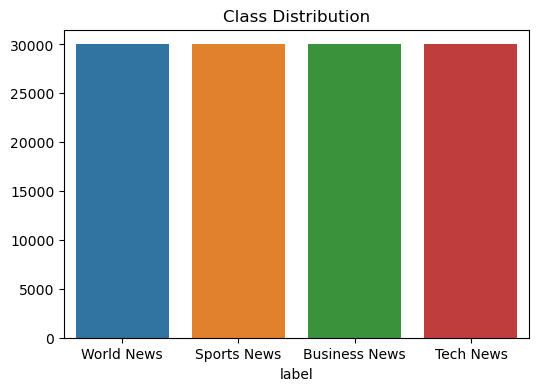

In [27]:
# Class Distribution Analysis
class_counts = train_data_eda['label'].value_counts()
plt.figure(figsize=(6, 4))
sns.barplot(x=class_counts.index, y=class_counts.values)
plt.xticks(range(4), ['World News', 'Sports News', 'Business News', 'Tech News'])
plt.title('Class Distribution')
plt.show()

In [28]:
test_data_eda.label.value_counts()

label
2    1900
3    1900
1    1900
0    1900
Name: count, dtype: int64

In [29]:
train_data_eda.isnull().sum()

text     0
label    0
dtype: int64

In [30]:
test_data_eda.isnull().sum()

text     0
label    0
dtype: int64

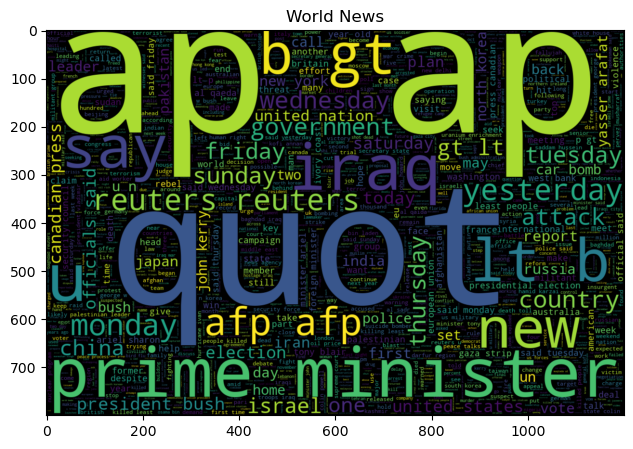

In [31]:
world1 = train_data_eda.text[train_data_eda.label[train_data_eda.label==0].index]
plt.figure(figsize = (10,5)) ;
wordcloud = WordCloud(min_font_size = 3,  max_words = 2500 , width = 1200 , height = 800).generate(" ".join(world1))
plt.title("World News")
plt.imshow(wordcloud,interpolation = 'bilinear');

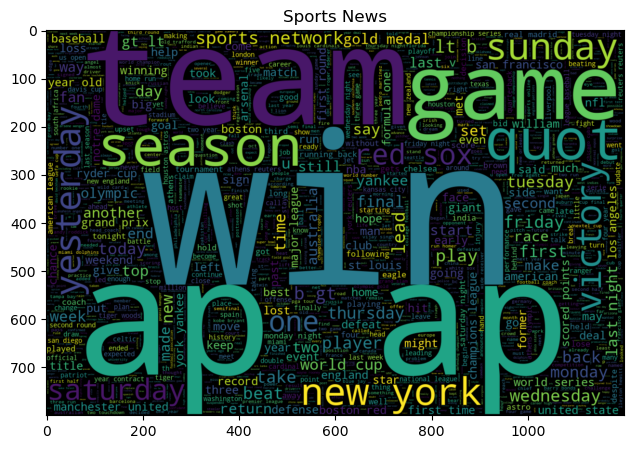

In [32]:
world2 = train_data_eda.text[train_data_eda.label[train_data_eda.label==1].index]
plt.figure(figsize = (10,5)) ;
wordcloud = WordCloud(min_font_size = 3,  max_words = 2500 , width = 1200 , height = 800).generate(" ".join(world2))
plt.title("Sports News")
plt.imshow(wordcloud,interpolation = 'bilinear');

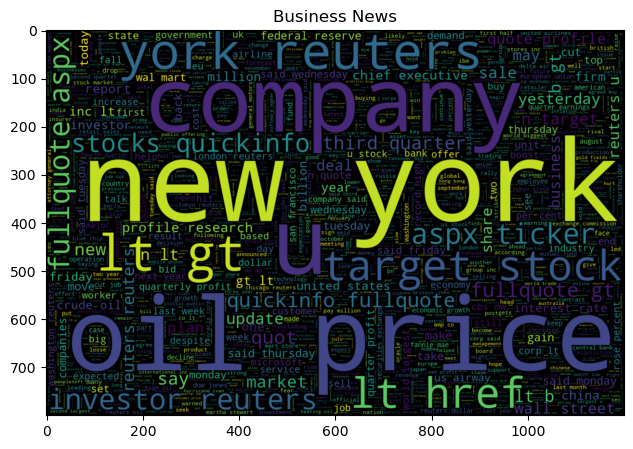

In [33]:
world3 = train_data_eda.text[train_data_eda.label[train_data_eda.label==2].index]
plt.figure(figsize = (10,5)) ;
wordcloud = WordCloud(min_font_size = 3,  max_words = 2500 , width = 1200 , height = 800).generate(" ".join(world3))
plt.title("Business News")
plt.imshow(wordcloud,interpolation = 'bilinear');

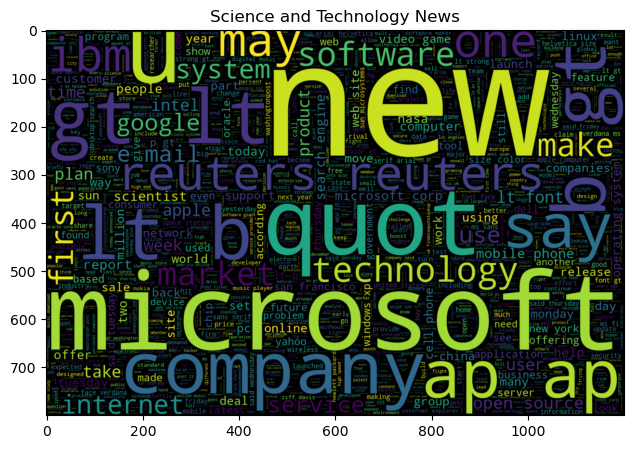

In [34]:
world4 = train_data_eda.text[train_data_eda.label[train_data_eda.label==3].index]
plt.figure(figsize = (10,5)) ;
wordcloud = WordCloud(min_font_size = 3,  max_words = 2500 , width = 1200 , height = 800).generate(" ".join(world4))
plt.title("Science and Technology News")
plt.imshow(wordcloud,interpolation = 'bilinear');

In [35]:
train_data_eda.head()

,text,label
0,wall st bears claw back black reuters reuters ...,2
1,carlyle looks toward commercial aerospace reut...,2
2,oil economy cloud stocks outlook reuters reute...,2
3,iraq halts oil exports main southern pipeline ...,2
4,oil prices soar time record posing new menace ...,2


In [39]:
!python -m spacy download en_core_web_sm

  Using cached https://github.com/explosion/spacy-models/releases/download/en_core_web_sm-3.7.0/en_core_web_sm-3.7.0-py3-none-any.whl (12.8 MB)
[+] Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [40]:
# NER Analysis
n = spacy.load('en_core_web_sm')
def perform_ner_column(text_column):
    d = list(n.pipe(text_column))
    n_e = defaultdict(list)
    e_c = defaultdict(Counter)
    for d1 in d:
        for e in d1.ents:
            n_e[e.label_].append(e.text)
            e_c[e.label_][e.text] += 1
    t_ee = {}
    for l, c in e_c.items():
        t_ee[l] = [entity for entity, c1 in c.most_common(50)]
    return t_ee
t_c = train_data_eda["text"][:10000]
t_e = perform_ner_column(t_c)
for l, e in t_e.items():
    print(f"{l}: {e}")

ORG: ['microsoft', 'google', 'ibm', 'reuters', 'nasa', 'href http www investor reuters', 'new york', 'un', 'wal mart', 'sec', 'new york reuters', 'al qaeda', 'intel', 'nec', 'yahoo', 'google inc', 'united nations', 'sony', 'cbs', 'united airlines', 'hamas', 'ford', 'motorola', 'gymnastics', 'fed', 'macromedia', 'cnn', 'al qaida', 'white house', 'iraq reuters', 'href http', 'congress', 'fcc', 'taliban', 'senate', 'boeing', 'army', 'playboy', 'nbc', 'hewlett packard', 'apple', 'san francisco reuters', 'london reuters', 'lilly', 'washington reuters', 'treasury', 'warner', 'gop', 'pentagon', 'supreme court']
PERSON: ['bush', 'quot', 'michael phelps', 'john kerry', 'hugo chavez', 'ariel sharon', 'paul hamm', 'serif', 'helvetica', 'abu ghraib', 'kerry', 'hamid karzai', 'muqtada al sadr', 'al sadr', 'moqtada al sadr', 'johnson', 'bobby fischer', 'justin gatlin', 'sharon', 'chavez', 'george w bush', 'williams', 'vladimir putin', 'gatlin', 'sadr', 'tony blair', 'arafat', 'yasser arafat', 'osama

In [41]:
# Training Word2Vec model
sentences = [text.split() for text in train_data_eda['text']]
model_word2vec = Word2Vec(sentences, vector_size=100, window=5, min_count=1, sg=0)

In [42]:
# Word Similarity Analysis
similar_words_prime = model_word2vec.wv.most_similar("prime")
print("Words similar to 'prime':")
for word, similarity in similar_words_prime:
    print(f"{word}: {similarity}")

Words similar to 'prime':
shivraj: 0.8180176615715027
patil: 0.7756974101066589
saeb: 0.7712118029594421
goggins: 0.7629834413528442
shankar: 0.7602601647377014
lapierre: 0.7532093524932861
ferzili: 0.7510062456130981
namo: 0.7479259967803955
giuseppe: 0.741716742515564
trutnev: 0.7333362698554993


In [43]:
similar_words_game = model_word2vec.wv.most_similar("game")
print("Words similar to 'game':")
for word, similarity in similar_words_game:
    print(f"{word}: {similarity}")

Words similar to 'game':
games: 0.7407466173171997
tragicomedy: 0.6443561315536499
play: 0.5793980956077576
opus: 0.563563346862793
franchise: 0.5523635149002075
postseason: 0.5516403317451477
nfl: 0.549325704574585
nf: 0.5399181842803955
matchup: 0.530700147151947
contests: 0.5249840617179871


In [44]:
similar_words_company = model_word2vec.wv.most_similar("company")
print("Words similar to 'company':")
for word, similarity in similar_words_company:
    print(f"{word}: {similarity}")

Words similar to 'company':
giant: 0.7801956534385681
firm: 0.7250539660453796
companies: 0.6522963047027588
maker: 0.6130403280258179
unit: 0.6063849925994873
supplier: 0.6047080159187317
subsidiary: 0.6003729104995728
assets: 0.566617488861084
acquisition: 0.56396484375
companys: 0.5544582009315491


In [45]:
similar_words_microsoft = model_word2vec.wv.most_similar("microsoft")
print("Words similar to 'microsoft':")
for word, similarity in similar_words_microsoft:
    print(f"{word}: {similarity}")

Words similar to 'microsoft':
windows: 0.6716970801353455
sp: 0.6532229781150818
xp: 0.6471339464187622
longhorn: 0.6181398034095764
microsofts: 0.6069549918174744
pennichuck: 0.5966167449951172
aol: 0.595982551574707
symantec: 0.5920802354812622
oracle: 0.5833308696746826
novell: 0.5741749405860901


In [46]:
train_data_eda_1 = train_data_eda.copy()
test_data_eda_1 = test_data_eda.copy()
train_data_eda_1['word_count'] = train_data_eda_1['text'].apply(lambda x: len(x.split()))
train_data_eda_1['char_count'] = train_data_eda_1['text'].apply(len)
train_data_eda_1['avg_word_length'] = train_data_eda_1['char_count'] / train_data_eda_1['word_count']
test_data_eda_1['char_count'] = test_data_eda_1['text'].apply(len)
test_data_eda_1['word_count'] = test_data_eda_1['text'].apply(lambda x: len(x.split()))
test_data_eda_1['avg_word_length'] = test_data_eda_1['char_count'] / test_data_eda_1['word_count']

In [47]:
train_data_eda_1.head()

,text,label,word_count,char_count,avg_word_length
0,wall st bears claw back black reuters reuters ...,2,18,112,6.222222
1,carlyle looks toward commercial aerospace reut...,2,27,214,7.925926
2,oil economy cloud stocks outlook reuters reute...,2,24,166,6.916667
3,iraq halts oil exports main southern pipeline ...,2,29,214,7.379310
4,oil prices soar time record posing new menace ...,2,30,199,6.633333


In [48]:
test_data_eda_1.head()

,text,label,char_count,word_count,avg_word_length
0,fears n pension talks unions representing work...,2,121,17,7.117647
1,race second private team sets launch date huma...,3,252,36,7.000000
2,ky company wins grant study peptides ap ap com...,3,198,27,7.333333
3,prediction unit helps forecast wildfires ap ap...,3,226,34,6.647059
4,calif aims limit farm related smog ap ap south...,3,184,28,6.571429


In [51]:
correlation_matrix = test_data_eda_1[['label', 'char_count', 'word_count', 'avg_word_length']].corr()
correlation_with_label = correlation_matrix['label'].sort_values(ascending=False)
correlation_with_label # Correlation is very less, cannot be considered

label              1.000000
avg_word_length    0.019596
char_count         0.015740
word_count         0.015450
Name: label, dtype: float64

## Feature engineering and feature selection

In [52]:
train_data.head()

,text,label
0,wall st bears claw back black reuters reuters ...,2
1,carlyle looks toward commercial aerospace reut...,2
2,oil economy cloud stocks outlook reuters reute...,2
3,iraq halts oil exports main southern pipeline ...,2
4,oil prices soar time record posing new menace ...,2


In [53]:
test_data.head()

,text,label
0,fears n pension talks unions representing work...,2
1,race second private team sets launch date huma...,3
2,ky company wins grant study peptides ap ap com...,3
3,prediction unit helps forecast wildfires ap ap...,3
4,calif aims limit farm related smog ap ap south...,3


In [91]:
train_data.to_csv('train_data.csv', index=False)
test_data.to_csv('test_data.csv', index=False)

In [54]:
LABEL = train_data["label"]
LABEL

0         2
1         2
2         2
3         2
4         2
         ..
119995    0
119996    1
119997    1
119998    1
119999    1
Name: label, Length: 120000, dtype: int64

In [55]:
LABEL_TEST = test_data["label"]
LABEL_TEST

0       2
1       3
2       3
3       3
4       3
       ..
7595    0
7596    1
7597    1
7598    2
7599    2
Name: label, Length: 7600, dtype: int64

In [93]:
# Define the Fields for text and labels
TEXT = Field(sequential=True, tokenize=tokenize_text, lower=True, include_lengths=True)
LABEL = LabelField(dtype=torch.long)

In [96]:
# Create the TabularDatasets
train_data, test_data = TabularDataset.splits(
    path='.', train='train_data.csv', test='test_data.csv',
    format='csv', fields=[('text', TEXT), ('label', LABEL)])

In [97]:
# Build the vocabulary
TEXT.build_vocab(train_data, max_size=vocab_size)
LABEL.build_vocab(train_data)

In [98]:
# Create iterators for the datasets
train_iterator, test_iterator = BucketIterator.splits(
    (train_data, test_data), batch_size=batch_size, sort_key=lambda x: len(x.text))

In [100]:
# Print the first 5 elements in the training dataset
for batch in train_iterator:
    text, text_lengths = batch.text
    label = batch.label
    for i in range(min(5, batch.batch_size)):  # Display only the first 5 elements
        print(f"Text: {text[:, i]}")
        print(f"Label: {label[i]}")
        print()

Text: tensor([   4,    2,  323,    2,    3,    2,  930,    2,    3,    2, 1260,    2,
           3,    2, 2247,    2,    3,    2, 8047,    2,    3,    2, 5964,    2,
           3,    2, 1557,    2,    3,    2, 2477,    2,    3,    2, 5473,    2,
           3,    2,  387,    2,    3,    2, 2531,    2,    3,    2, 2948,    2,
           3,    2,  765,    2,    3,    2, 2861,    2,    3,    2, 5521,    2,
           3,    2,    0,    2,    3,    2,  754,    2,    3,    2,  871,    2,
           3,    2, 2789,    2,    3,    2, 6159,    2,    3,    2,    0,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2, 9407,    2,    3,    2,  421,    2,
           3,    2,   83,    2,    3,    2,  145,    2,    3,    2,  405,    2,
           3,    2,    9,    2,    3,    2,    9,    2,    3,    2,    0,    2,
           3,    2, 9901,    2,    3,    2,  412,    2,    3,    2, 2784,    2,
           3,    2, 5988,    2,    3,    2,  515,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2,    0,    2,    3,    2, 6063,    2,
           3,    2, 7400,    2,    3,    2, 5626,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2,  538,    2,    3,    2,  117,    2,
           3,    2,  751,    2,    3,    2,    0,    2,    3,    2,   34,    2,
           3,    2,   83,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1])
Label: 3

Text: tensor([   4,    2, 9029,    2,    

Text: tensor([   4,    2,    0,    2,    3,    2,  752,    2,    3,    2,   73,    2,
           3,    2, 5480,    2,    3,    2,  681,    2,    3,    2,  337,    2,
           3,    2,   42,    2,    3,    2,  105,    2,    3,    2,  424,    2,
           3,    2,    0,    2,    3,    2, 3110,    2,    3,    2, 2285,    2,
           3,    2, 6483,    2,    3,    2,  675,    2,    3,    2,  627,    2,
           3,    2, 2130,    2,    3,    2,    0,    2,    3,    2, 8125,    2,
           3,    2,  917,    2,    3,    2, 6780,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1])
Label: 0

Text: tensor([   4,    2, 1762,    2,    3,    2,  995,    2,    

Text: tensor([   4,    2,  132,    2,    3,    2,  131,    2,    3,    2, 7115,    2,
           3,    2,  828,    2,    3,    2,  861,    2,    3,    2,  132,    2,
           3,    2, 1269,    2,    3,    2,   99,    2,    3,    2,    0,    2,
           3,    2,  299,    2,    3,    2, 8435,    2,    3,    2, 1137,    2,
           3,    2,  828,    2,    3,    2, 6037,    2,    3,    2,  131,    2,
           3,    2,  383,    2,    3,    2, 4009,    2,    3,    2,  336,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1])
Label: 2

Text: ten

Text: tensor([   4,    2,  388,    2,    3,    2, 7090,    2,    3,    2, 2571,    2,
           3,    2, 9967,    2,    3,    2,  215,    2,    3,    2,  157,    2,
           3,    2,  806,    2,    3,    2,  388,    2,    3,    2, 1633,    2,
           3,    2, 7090,    2,    3,    2, 2571,    2,    3,    2,    0,    2,
           3,    2,  201,    2,    3,    2,  886,    2,    3,    2,  264,    2,
           3,    2,   26,    2,    3,    2,  886,    2,    3,    2,   97,    2,
           3,    2,    7,    2,    3,    2, 2864,    2,    3,    2,    0,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 1204,    2,    3,    2, 3179,    2,    3,    2,   19,    2,
           3,    2,   54,    2,    3,    2, 1226,    2,    3,    2,  254,    2,
           3,    2,   79,    2,    3,    2,  312,    2,    3,    2,  927,    2,
           3,    2, 1204,    2,    3,    2,  123,    2,    3,    2,  296,    2,
           3,    2,  397,    2,    3,    2,   54,    2,    3,    2, 1297,    2,
           3,    2,    0,    2,    3,    2, 2282,    2,    3,    2,  296,    2,
           3,    2,  600,    2,    3,    2,  397,    2,    3,    2, 2468,    2,
           3,    2,  145,    2,    3,    2,  103,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2241,    2,    3,    2, 1591,    2,    3,    2,   55,    2,
           3,    2, 1493,    2,    3,    2, 1167,    2,    3,    2,   40,    2,
           3,    2, 5303,    2,    3,    2, 6667,    2,    3,    2, 5951,    2,
           3,    2, 5953,    2,    3,    2, 2241,    2,    3,    2,    9,    2,
           3,    2, 4044,    2,    3,    2,   97,    2,    3,    2,   69,    2,
           3,    2, 1591,    2,    3,    2,   33,    2,    3,    2,   55,    2,
           3,    2,  364,    2,    3,    2, 2571,    2,    3,    2, 3674,    2,
           3,    2,  146,    2,    3,    2, 1534,    2,    3,    2,    0,    2,
           3,    2, 1493,    2,    3,    2, 1167,    2,    3,    2, 4784,    2,
           3,    2,   90,    2,    3,    2,  464,    2,    3,    2,   97,    2,
           3,    2,  586,    2,    3,    2, 1054,    2,    3,    2, 1533,    2,
           3,    2,    0,    2,    3,    2, 1412,    2,    5,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2, 1401,    2,    3,    2,  655,    2,
           3,    2, 5686,    2,    3,    2, 2190,    2,    3,    2,  361,    2,
           3,    2,  202,    2,    3,    2, 3764,    2,    3,    2, 9902,    2,
           3,    2, 2003,    2,    3,    2,    0,    2,    3,    2,  655,    2,
           3,    2,    0,    2,    3,    2, 8899,    2,    3,    2, 1058,    2,
           3,    2, 1439,    2,    3,    2,  774,    2,    3,    2, 4021,    2,
           3,    2,  399,    2,    3,    2, 1213,    2,    3,    2,  171,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,   55,    2,    3,    2, 1121,    2,    3,    2,  314,    2,
           3,    2,  784,    2,    3,    2, 2119,    2,    3,    2, 5195,    2,
           3,    2, 7922,    2,    3,    2,  314,    2,    3,    2, 2129,    2,
           3,    2, 2119,    2,    3,    2,  140,    2,    3,    2,  288,    2,
           3,    2, 1740,    2,    3,    2,   45,    2,    3,    2, 1735,    2,
           3,    2,   55,    2,    3,    2, 5195,    2,    3,    2, 8343,    2,
           3,    2,  451,    2,    3,    2, 1104,    2,    3,    2,   75,    2,
           3,    2,  179,    2,    3,    2,    0,    2,    3,    2,   82,    2,
           3,    2,  348,    2,    3,    2,  125,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 9606,    2,    3,    2, 3525,    2,    3,    2, 1845,    2,
           3,    2, 1714,    2,    3,    2, 1049,    2,    3,    2,    9,    2,
           3,    2,    9,    2,    3,    2, 9606,    2,    3,    2,    0,    2,
           3,    2, 2297,    2,    3,    2,   21,    2,    3,    2, 3760,    2,
           3,    2, 1845,    2,    3,    2,   55,    2,    3,    2,   93,    2,
           3,    2, 1049,    2,    3,    2, 5948,    2,    3,    2, 7439,    2,
           3,    2, 1053,    2,    3,    2, 2059,    2,    3,    2,  709,    2,
           3,    2, 2535,    2,    3,    2,   19,    2,    3,    2, 1714,    2,
           3,    2,   74,    2,    3,    2,    0,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  345,    2,    3,    2,    0,    2,    3,    2,    7,    2,
           3,    2, 9595,    2,    3,    2,    0,    2,    3,    2,    0,    2,
           3,    2,   51,    2,    3,    2,   80,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2, 8372,    2,    3,    2, 2996,    2,
           3,    2, 1246,    2,    3,    2, 3067,    2,    3,    2,  228,    2,
           3,    2, 1825,    2,    3,    2, 5736,    2,    3,    2, 1835,    2,
           3,    2, 2533,    2,    3,    2, 2200,    2,    3,    2, 4558,    2,
           3,    2,  172,    2,    3,    2,   14,    2,    3,    2,   39,    2,
           3,    2, 5192,    2,    3,    2, 3831,    2,    3,    2,   51,    2,
           3,    2,  101,    2,    3,    2,  515,    2,    3,    2,   19,    2,
           3,    2,  238,    2,    3,    2, 4807,    2,    3,    2,   16,    2,
           3,    2,  345,    2,    3,    2,    0,    2,    3,    2,   16,    2,
           3,    2, 1046,    2,   

Text: tensor([   4,    2,   79,    2,    3,    2,    0,    2,    3,    2, 7744,    2,
           3,    2,   35,    2,    3,    2, 6413,    2,    3,    2,  169,    2,
           3,    2,   13,    2,    3,    2, 3825,    2,    3,    2,   79,    2,
           3,    2,  312,    2,    3,    2,   61,    2,    3,    2,  882,    2,
           3,    2, 1216,    2,    3,    2, 1137,    2,    3,    2,  109,    2,
           3,    2, 1075,    2,    3,    2, 1449,    2,    3,    2,   35,    2,
           3,    2,   41,    2,    3,    2,   49,    2,    3,    2,  324,    2,
           3,    2,    0,    2,    3,    2,  372,    2,    3,    2, 1165,    2,
           3,    2, 5404,    2,    3,    2, 1163,    2,    3,    2,  723,    2,
           3,    2,  281,    2,    3,    2,  485,    2,    3,    2, 1222,    2,
           3,    2,    0,    2,    3,    2, 1462,    2,    3,    2, 3228,    2,
           3,    2,  865,    2,    3,    2, 1075,    2,    3,    2,  801,    2,
           3,    2, 3695,    2,   

Text: tensor([   4,    2, 3378,    2,    3,    2, 3180,    2,    3,    2,  741,    2,
           3,    2,   23,    2,    3,    2,   70,    2,    3,    2,  461,    2,
           3,    2,  484,    2,    3,    2, 7569,    2,    3,    2,  126,    2,
           3,    2, 5604,    2,    3,    2, 1240,    2,    3,    2, 2503,    2,
           3,    2,  403,    2,    3,    2,  168,    2,    3,    2,  647,    2,
           3,    2,  366,    2,    3,    2, 1166,    2,    3,    2, 2459,    2,
           3,    2,   29,    2,    3,    2, 1206,    2,    3,    2, 3378,    2,
           3,    2, 3180,    2,    3,    2,  189,    2,    3,    2,  328,    2,
           3,    2, 1402,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text: tensor([   4,    2,  835,    2,    3,    2,   51,    2,    3,    2,  347,    2,
           3,    2, 1957,    2,    3,    2, 1126,    2,    3,    2,  207,    2,
           3,    2, 3108,    2,    3,    2,   18,    2,    3,    2,    8,    2,
           3,    2,    8,    2,    3,    2,  835,    2,    3,    2,  189,    2,
           3,    2,  347,    2,    3,    2, 1957,    2,    3,    2,  207,    2,
           3,    2, 5672,    2,    3,    2, 1126,    2,    3,    2,  701,    2,
           3,    2, 1177,    2,    3,    2,   18,    2,    3,    2, 2967,    2,
           3,    2,    7,    2,    3,    2,   45,    2,    3,    2, 1948,    2,
           3,    2,  189,    2,    3,    2,   47,    2,    3,    2, 4037,    2,
           3,    2,  161,    2,    3,    2, 1126,    2,    3,    2,  109,    2,
           3,    2,    0,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1])
Label: 0

Text: tensor([   4,    2, 4085,    2,    3,    2, 1809,    2,    

Text: tensor([   4,    2,  224,    2,    3,    2,  199,    2,    3,    2,  266,    2,
           3,    2,  224,    2,    3,    2,   41,    2,    3,    2,    0,    2,
           3,    2,  410,    2,    3,    2,  417,    2,    3,    2,  148,    2,
           3,    2,  199,    2,    3,    2,  147,    2,    3,    2,  266,    2,
           3,    2, 1399,    2,    3,    2, 1626,    2,    3,    2, 1651,    2,
           3,    2,   85,    2,    3,    2, 5310,    2,    3,    2, 4030,    2,
           3,    2, 2296,    2,    3,    2,  385,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,   94,    2,    3,    2,   59,    2,
           3,    2, 5602,    2,    3,    2,  131,    2,    3,    2,  328,    2,
           3,    2,   41,    2,    3,    2,    0,    2,    3,    2,   51,    2,
           3,    2,  410,    2,    3,    2,  417,    2,    3,    2,  148,    2,
           3,    2,   10,    2,    3,    2,  131,    2,    3,    2,   25,    2,
           3,    2,    7,    2,    3,    2,   67,    2,    3,    2,   71,    2,
           3,    2,   94,    2,    3,    2,  258,    2,    3,    2,   59,    2,
           3,    2,  649,    2,    3,    2, 1715,    2,    3,    2, 9633,    2,
           3,    2,  336,    2,    3,    2,   41,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  424,    2,    3,    2, 8517,    2,    3,    2,  613,    2,
           3,    2, 4020,    2,    3,    2, 2918,    2,    3,    2,    9,    2,
           3,    2,    9,    2,    3,    2,  424,    2,    3,    2, 3437,    2,
           3,    2,   14,    2,    3,    2, 2918,    2,    3,    2,  613,    2,
           3,    2, 4020,    2,    3,    2,   23,    2,    3,    2, 2641,    2,
           3,    2,  149,    2,    3,    2,  347,    2,    3,    2,  361,    2,
           3,    2, 1207,    2,    3,    2, 1811,    2,    3,    2,  547,    2,
           3,    2,  148,    2,    3,    2, 8942,    2,    3,    2,   83,    2,
           3,    2,  683,    2,    3,    2,  238,    2,    3,    2,  377,    2,
           3,    2, 1572,    2,    3,    2,   56,    2,    3,    2,  110,    2,
           3,    2,    6,    2,    3,    2, 7863,    2,    3,    2, 1024,    2,
           3,    2, 7031,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2046,    2,    3,    2,   92,    2,    3,    2, 5826,    2,
           3,    2,  265,    2,    3,    2,  611,    2,    3,    2,  114,    2,
           3,    2,    0,    2,    3,    2,  917,    2,    3,    2, 1702,    2,
           3,    2, 2046,    2,    3,    2,    8,    2,    3,    2,   92,    2,
           3,    2,  542,    2,    3,    2,    0,    2,    3,    2, 2046,    2,
           3,    2,    0,    2,    3,    2,   48,    2,    3,    2, 1786,    2,
           3,    2,  149,    2,    3,    2,  611,    2,    3,    2,   26,    2,
           3,    2,  114,    2,    3,    2,    0,    2,    3,    2,  119,    2,
           3,    2, 5270,    2,    3,    2,  295,    2,    3,    2,  961,    2,
           3,    2, 2435,    2,    3,    2, 1941,    2,    3,    2,   50,    2,
           3,    2,   97,    2,    3,    2,    7,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  399,    2,    3,    2,   14,    2,    3,    2, 3771,    2,
           3,    2,  487,    2,    3,    2,  689,    2,    3,    2,  890,    2,
           3,    2, 5286,    2,    3,    2, 3849,    2,    3,    2, 3901,    2,
           3,    2, 1007,    2,    3,    2,   58,    2,    3,    2,   58,    2,
           3,    2,  399,    2,    3,    2,   14,    2,    3,    2, 3771,    2,
           3,    2,    0,    2,    3,    2,  617,    2,    3,    2,  689,    2,
           3,    2,  228,    2,    3,    2,  233,    2,    3,    2,    0,    2,
           3,    2, 2307,    2,    3,    2, 5286,    2,    3,    2,    0,    2,
           3,    2, 3849,    2,    3,    2, 1459,    2,    3,    2,    0,    2,
           3,    2,   16,    2,    3,    2, 3901,    2,    3,    2, 1007,    2,
           3,    2,   16,    2,    3,    2, 1736,    2,    3,    2, 2609,    2,
           3,    2,    0,    2,    3,    2, 2552,    2,    3,    2, 1088,    2,
           5,    1,    1,    1,   

Text: tensor([   4,    2, 6008,    2,    3,    2, 1287,    2,    3,    2, 6426,    2,
           3,    2,   96,    2,    3,    2, 9732,    2,    3,    2,  144,    2,
           3,    2,    0,    2,    3,    2, 9732,    2,    3,    2, 6008,    2,
           3,    2, 1287,    2,    3,    2,    0,    2,    3,    2, 8473,    2,
           3,    2, 1907,    2,    3,    2,   96,    2,    3,    2, 9732,    2,
           3,    2,  313,    2,    3,    2,  144,    2,    3,    2,   45,    2,
           3,    2, 2882,    2,    3,    2, 1625,    2,    3,    2,  608,    2,
           3,    2, 3762,    2,    3,    2,  293,    2,    3,    2,   13,    2,
           3,    2,  787,    2,    3,    2, 1823,    2,    3,    2, 1660,    2,
           3,    2, 1950,    2,    3,    2,    0,    2,    3,    2,  513,    2,
           3,    2,  149,    2,    3,    2,  108,    2,    3,    2,  119,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,   42,    2,    3,    2,  893,    2,    3,    2,  472,    2,
           3,    2,  370,    2,    3,    2,   42,    2,    3,    2,  599,    2,
           3,    2, 9842,    2,    3,    2,  584,    2,    3,    2,  467,    2,
           3,    2, 1197,    2,    3,    2,  199,    2,    3,    2,   36,    2,
           3,    2,   10,    2,    3,    2,  446,    2,    3,    2, 1886,    2,
           3,    2, 6696,    2,    3,    2, 6314,    2,    3,    2,  151,    2,
           3,    2, 1632,    2,    3,    2, 3749,    2,    3,    2,  155,    2,
           3,    2,  467,    2,    3,    2, 1820,    2,    3,    2,   32,    2,
           3,    2,  687,    2,    3,    2, 2306,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 3497,    2,    3,    2,  432,    2,    3,    2,   64,    2,
           3,    2, 2229,    2,    3,    2, 2021,    2,    3,    2,  309,    2,
           3,    2,   92,    2,    3,    2, 6096,    2,    3,    2,   34,    2,
           3,    2, 5701,    2,    3,    2, 3497,    2,    3,    2,   13,    2,
           3,    2,   99,    2,    3,    2, 6158,    2,    3,    2,  432,    2,
           3,    2, 1822,    2,    3,    2,  939,    2,    3,    2, 4744,    2,
           3,    2,  309,    2,    3,    2, 4024,    2,    3,    2,  175,    2,
           3,    2, 2143,    2,    3,    2, 4087,    2,    3,    2,    7,    2,
           3,    2,   23,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 3209,    2,    3,    2,  425,    2,    3,    2, 1895,    2,
           3,    2, 3266,    2,    3,    2,    0,    2,    3,    2, 8487,    2,
           3,    2,  425,    2,    3,    2, 3209,    2,    3,    2, 1679,    2,
           3,    2,   41,    2,    3,    2,    0,    2,    3,    2,  410,    2,
           3,    2,  417,    2,    3,    2,  148,    2,    3,    2, 2319,    2,
           3,    2,  355,    2,    3,    2,  469,    2,    3,    2,  233,    2,
           3,    2, 1219,    2,    3,    2, 3209,    2,    3,    2,  599,    2,
           3,    2,  910,    2,    3,    2, 2805,    2,    3,    2,  299,    2,
           3,    2,  756,    2,    3,    2,  919,    2,    3,    2, 1009,    2,
           3,    2,   20,    2,    3,    2,  584,    2,    3,    2, 1632,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2067,    2,    3,    2,    0,    2,    3,    2,   39,    2,
           3,    2,    0,    2,    3,    2, 3927,    2,    3,    2,  909,    2,
           3,    2, 4042,    2,    3,    2,    0,    2,    3,    2,  502,    2,
           3,    2,  284,    2,    3,    2, 1158,    2,    3,    2,  518,    2,
           3,    2,  179,    2,    3,    2,   57,    2,    3,    2,  230,    2,
           3,    2, 8804,    2,    3,    2,   23,    2,    3,    2,  361,    2,
           3,    2, 8912,    2,    3,    2,   96,    2,    3,    2, 1828,    2,
           3,    2,   67,    2,    3,    2,  448,    2,    3,    2,   37,    2,
           3,    2,    0,    2,    3,    2, 5683,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 3192,    2,    3,    2,  582,    2,    3,    2,   88,    2,
           3,    2, 1466,    2,    3,    2, 4387,    2,    3,    2, 1466,    2,
           3,    2, 4387,    2,    3,    2,  330,    2,    3,    2, 4540,    2,
           3,    2,  621,    2,    3,    2,   88,    2,    3,    2, 1168,    2,
           3,    2,  215,    2,    3,    2,  157,    2,    3,    2, 5207,    2,
           3,    2, 3192,    2,    3,    2,    7,    2,    3,    2, 1680,    2,
           3,    2, 1428,    2,    3,    2,   24,    2,    3,    2, 7142,    2,
           3,    2, 7405,    2,    3,    2,  550,    2,    3,    2, 3886,    2,
           3,    2,  806,    2,    3,    2,  388,    2,    3,    2,  374,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,   35,    2,    3,    2,  168,    2,    3,    2,  486,    2,
           3,    2,  987,    2,    3,    2, 8746,    2,    3,    2, 3469,    2,
           3,    2,   40,    2,    3,    2,   35,    2,    3,    2,  490,    2,
           3,    2,  286,    2,    3,    2,    7,    2,    3,    2,   20,    2,
           3,    2,  168,    2,    3,    2,  486,    2,    3,    2,  987,    2,
           3,    2,  106,    2,    3,    2,  402,    2,    3,    2, 1148,    2,
           3,    2, 3459,    2,    3,    2, 5283,    2,    3,    2,    0,    2,
           3,    2, 5318,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,   75,    2,    3,    2, 7177,    2,    3,    2,  997,    2,
           3,    2,  508,    2,    3,    2, 8425,    2,    3,    2,    9,    2,
           3,    2,    9,    2,    3,    2,   75,    2,    3,    2,  488,    2,
           3,    2,    0,    2,    3,    2,  658,    2,    3,    2, 6405,    2,
           3,    2, 1746,    2,    3,    2, 8425,    2,    3,    2,  126,    2,
           3,    2,    0,    2,    3,    2, 1152,    2,    3,    2, 1778,    2,
           3,    2,  501,    2,    3,    2,  146,    2,    3,    2, 2180,    2,
           3,    2,  508,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text: tensor([   4,    2,  132,    2,    3,    2, 3244,    2,    3,    2, 4212,    2,
           3,    2, 1300,    2,    3,    2,  296,    2,    3,    2,  453,    2,
           3,    2,   30,    2,    3,    2,   58,    2,    3,    2,   58,    2,
           3,    2,  132,    2,    3,    2, 1524,    2,    3,    2, 4212,    2,
           3,    2, 1300,    2,    3,    2,  296,    2,    3,    2,  881,    2,
           3,    2,  401,    2,    3,    2,  231,    2,    3,    2, 1003,    2,
           3,    2,  931,    2,    3,    2,  452,    2,    3,    2,   30,    2,
           3,    2,  583,    2,    3,    2,  699,    2,    3,    2,  228,    2,
           3,    2, 1368,    2,    3,    2, 4935,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,   44,    2,    3,    2,  353,    2,    3,    2,   22,    2,
           3,    2,  534,    2,    3,    2,   73,    2,    3,    2,  888,    2,
           3,    2,    8,    2,    3,    2, 3348,    2,    3,    2,  375,    2,
           3,    2,  353,    2,    3,    2,  824,    2,    3,    2,  127,    2,
           3,    2,   21,    2,    3,    2,   22,    2,    3,    2,   46,    2,
           3,    2,  104,    2,    3,    2,    6,    2,    3,    2, 1538,    2,
           3,    2,  264,    2,    3,    2,  188,    2,    3,    2, 1522,    2,
           3,    2,   18,    2,    3,    2,  193,    2,    3,    2, 1124,    2,
           3,    2, 5922,    2,    3,    2,   86,    2,    3,    2,  817,    2,
           3,    2,  858,    2,    3,    2, 1177,    2,    3,    2,  464,    2,
           3,    2,   17,    2,    3,    2,  124,    2,    3,    2,  282,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,  308,    2,    3,    2, 4259,    2,
           3,    2,    0,    2,    3,    2,    0,    2,    3,    2,  502,    2,
           3,    2,  284,    2,    3,    2, 6273,    2,    3,    2,    0,    2,
           3,    2,  998,    2,    3,    2, 2972,    2,    3,    2,   14,    2,
           3,    2,   39,    2,    3,    2,  118,    2,    3,    2,  163,    2,
           3,    2,   63,    2,    3,    2, 2341,    2,    3,    2, 1607,    2,
           3,    2, 7708,    2,    3,    2,   33,    2,    3,    2,  231,    2,
           3,    2, 5472,    2,    3,    2,  284,    2,    3,    2, 2004,    2,
           3,    2, 3039,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  906,    2,    3,    2,  115,    2,    3,    2,    0,    2,
           3,    2,  367,    2,    3,    2, 5488,    2,    3,    2, 5375,    2,
           3,    2, 1106,    2,    3,    2, 5508,    2,    3,    2, 4689,    2,
           3,    2, 5375,    2,    3,    2,  742,    2,    3,    2, 6147,    2,
           3,    2,   19,    2,    3,    2,  454,    2,    3,    2,  110,    2,
           3,    2,   26,    2,    3,    2, 5488,    2,    3,    2,   90,    2,
           3,    2,   79,    2,    3,    2,  106,    2,    3,    2,  220,    2,
           3,    2,   29,    2,    3,    2, 1576,    2,    3,    2, 9537,    2,
           3,    2,  142,    2,    3,    2,  906,    2,    3,    2,  115,    2,
           3,    2,   64,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,    0,    2,    3,    2,   35,    2,
           3,    2,  187,    2,    3,    2,  833,    2,    3,    2,  394,    2,
           3,    2,   20,    2,    3,    2,  756,    2,    3,    2,    7,    2,
           3,    2,   50,    2,    3,    2,    0,    2,    3,    2, 1067,    2,
           3,    2,    0,    2,    3,    2,  394,    2,    3,    2,   79,    2,
           3,    2, 2588,    2,    3,    2,  884,    2,    3,    2,   35,    2,
           3,    2,    0,    2,    3,    2,  411,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1])
Label: 3

Text: tensor([   4,    2,  444,    2,    

Text: tensor([   4,    2, 2846,    2,    3,    2, 1720,    2,    3,    2,    0,    2,
           3,    2, 1266,    2,    3,    2,   17,    2,    3,    2,  115,    2,
           3,    2, 2846,    2,    3,    2,  261,    2,    3,    2, 6319,    2,
           3,    2,   67,    2,    3,    2, 1599,    2,    3,    2, 2138,    2,
           3,    2, 3386,    2,    3,    2, 1702,    2,    3,    2,   66,    2,
           3,    2, 6572,    2,    3,    2,  101,    2,    3,    2, 2108,    2,
           3,    2, 2203,    2,    3,    2,   17,    2,    3,    2,  115,    2,
           3,    2, 1266,    2,    3,    2, 3802,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 1174,    2,    3,    2, 2642,    2,    3,    2,  317,    2,
           3,    2,   81,    2,    3,    2,  567,    2,    3,    2,   14,    2,
           3,    2,  114,    2,    3,    2,   42,    2,    3,    2,  321,    2,
           3,    2,    8,    2,    3,    2,  623,    2,    3,    2, 1503,    2,
           3,    2,   18,    2,    3,    2, 6599,    2,    3,    2, 1392,    2,
           3,    2,  543,    2,    3,    2,   75,    2,    3,    2, 1670,    2,
           3,    2, 1174,    2,    3,    2,  570,    2,    3,    2, 2642,    2,
           3,    2,  317,    2,    3,    2,   81,    2,    3,    2,   25,    2,
           3,    2, 1269,    2,    3,    2,  830,    2,    3,    2,  114,    2,
           3,    2,  680,    2,    3,    2, 1486,    2,    3,    2,   18,    2,
           3,    2,   97,    2,    3,    2,    7,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  407,    2,    3,    2, 4320,    2,    3,    2,  931,    2,
           3,    2,  940,    2,    3,    2,    8,    2,    3,    2,    8,    2,
           3,    2,  698,    2,    3,    2,   33,    2,    3,    2,   52,    2,
           3,    2,   36,    2,    3,    2, 4269,    2,    3,    2, 4435,    2,
           3,    2,  631,    2,    3,    2,  228,    2,    3,    2,  239,    2,
           3,    2,    0,    2,    3,    2, 1822,    2,    3,    2,  902,    2,
           3,    2,    0,    2,    3,    2,   80,    2,    3,    2, 1490,    2,
           3,    2,    0,    2,    3,    2, 9877,    2,    3,    2,   76,    2,
           3,    2,   14,    2,    3,    2, 4372,    2,    3,    2,  614,    2,
           3,    2,  931,    2,    3,    2,  292,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2323,    2,    3,    2,  371,    2,    3,    2,   22,    2,
           3,    2,  989,    2,    3,    2,   86,    2,    3,    2, 2035,    2,
           3,    2,  716,    2,    3,    2,  675,    2,    3,    2,  371,    2,
           3,    2,   22,    2,    3,    2,  258,    2,    3,    2,   86,    2,
           3,    2,  571,    2,    3,    2,    6,    2,    3,    2,   31,    2,
           3,    2,  511,    2,    3,    2, 1177,    2,    3,    2,  660,    2,
           3,    2,  334,    2,    3,    2, 1262,    2,    3,    2, 1399,    2,
           3,    2,  616,    2,    3,    2,   10,    2,    3,    2,    0,    2,
           3,    2, 2421,    2,    3,    2,    0,    2,    3,    2, 1175,    2,
           3,    2, 5723,    2,    3,    2,  379,    2,    3,    2,  800,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,   94,    2,    3,    2, 4357,    2,
           3,    2,  198,    2,    3,    2, 6487,    2,    3,    2,   46,    2,
           3,    2, 1672,    2,    3,    2,   67,    2,    3,    2,   71,    2,
           3,    2,   94,    2,    3,    2,    0,    2,    3,    2,   27,    2,
           3,    2,  580,    2,    3,    2, 2486,    2,    3,    2,   20,    2,
           3,    2,    7,    2,    3,    2,   25,    2,    3,    2,    0,    2,
           3,    2,  198,    2,    3,    2, 6487,    2,    3,    2,   46,    2,
           3,    2, 2897,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 6167,    2,    3,    2,  393,    2,    3,    2,   40,    2,
           3,    2,  430,    2,    3,    2, 1875,    2,    3,    2, 2046,    2,
           3,    2, 4027,    2,    3,    2,    0,    2,    3,    2,    8,    2,
           3,    2, 6167,    2,    3,    2,  393,    2,    3,    2,    7,    2,
           3,    2,   24,    2,    3,    2,  430,    2,    3,    2, 1904,    2,
           3,    2, 6340,    2,    3,    2, 2046,    2,    3,    2, 4179,    2,
           3,    2,  542,    2,    3,    2, 2397,    2,    3,    2, 5628,    2,
           3,    2,    0,    2,    3,    2, 7027,    2,    3,    2,    0,    2,
           3,    2, 3186,    2,    3,    2, 1056,    2,    3,    2,  677,    2,
           3,    2, 6167,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,   92,    2,    3,    2,    0,    2,    3,    2, 2795,    2,
           3,    2, 5815,    2,    3,    2,  418,    2,    3,    2, 2771,    2,
           3,    2,  717,    2,    3,    2,  234,    2,    3,    2, 2795,    2,
           3,    2, 5815,    2,    3,    2,   92,    2,    3,    2,  529,    2,
           3,    2,  926,    2,    3,    2,   67,    2,    3,    2, 3702,    2,
           3,    2,  121,    2,    3,    2,  113,    2,    3,    2, 4059,    2,
           3,    2,  362,    2,    3,    2, 1201,    2,    3,    2,  684,    2,
           3,    2,  671,    2,    3,    2, 7888,    2,    3,    2, 6872,    2,
           3,    2,  268,    2,    3,    2,  681,    2,    3,    2,  793,    2,
           3,    2,  682,    2,    3,    2, 1456,    2,    3,    2,  717,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1])
Label: 1

Text: tensor([   4,    2,   83,    2,    3,    2, 3178,    2,    3,    2, 2465,    2,
   

Text: tensor([   4,    2, 7419,    2,    3,    2,  168,    2,    3,    2, 4647,    2,
           3,    2, 1379,    2,    3,    2,  461,    2,    3,    2, 9216,    2,
           3,    2, 7419,    2,    3,    2,  517,    2,    3,    2,  254,    2,
           3,    2, 1654,    2,    3,    2,   17,    2,    3,    2,  166,    2,
           3,    2, 1541,    2,    3,    2, 2721,    2,    3,    2,  370,    2,
           3,    2, 1379,    2,    3,    2,   64,    2,    3,    2,  138,    2,
           3,    2,   13,    2,    3,    2,  225,    2,    3,    2,   63,    2,
           3,    2,   16,    2,    3,    2, 1058,    2,    3,    2,  555,    2,
           3,    2, 4195,    2,    3,    2,  555,    2,    3,    2,    0,    2,
           3,    2,   16,    2,    3,    2, 7419,    2,    3,    2,    7,    2,
           3,    2,   32,    2,    3,    2,   63,    2,    3,    2, 3908,    2,
           3,    2,  825,    2,    3,    2,   19,    2,    3,    2,   65,    2,
           3,    2, 1379,    2,   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text: tensor([   4,    2,   10,    2,    3,    2,  426,    2,    3,    2,  987,    2,
           3,    2, 1546,    2,    3,    2,   42,    2,    3,    2,  105,    2,
           3,    2,  426,    2,    3,    2,  813,    2,    3,    2,   64,    2,
           3,    2, 1281,    2,    3,    2, 1546,    2,    3,    2,   32,    2,
           3,    2,  631,    2,    3,    2, 5861,    2,    3,    2, 1125,    2,
           3,    2,   64,    2,    3,    2, 2044,    2,    3,    2, 3546,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,  964,    2,    3,    2,  214,    2,
           3,    2, 2409,    2,    3,    2, 5364,    2,    3,    2,  127,    2,
           3,    2,    0,    2,    3,    2,  438,    2,    3,    2,   41,    2,
           3,    2,    0,    2,    3,    2,  410,    2,    3,    2,  417,    2,
           3,    2,  148,    2,    3,    2,   21,    2,    3,    2,    7,    2,
           3,    2,  104,    2,    3,    2,   13,    2,    3,    2,   19,    2,
           3,    2,  214,    2,    3,    2, 2409,    2,    3,    2,   49,    2,
           3,    2,  209,    2,    3,    2,   60,    2,    3,    2,   59,    2,
           3,    2,  127,    2,    3,    2,   20,    2,    3,    2,  538,    2,
           3,    2, 1741,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2401,    2,    3,    2,   35,    2,    3,    2, 3854,    2,
           3,    2, 2338,    2,    3,    2,  316,    2,    3,    2, 2067,    2,
           3,    2, 1753,    2,    3,    2, 7224,    2,    3,    2,  997,    2,
           3,    2,  333,    2,    3,    2,  579,    2,    3,    2, 4930,    2,
           3,    2,  218,    2,    3,    2, 2875,    2,    3,    2, 5398,    2,
           3,    2,  111,    2,    3,    2,  109,    2,    3,    2, 1794,    2,
           3,    2,   99,    2,    3,    2,    0,    2,    3,    2,  281,    2,
           3,    2,  485,    2,    3,    2,    0,    2,    3,    2,  309,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2580,    2,    3,    2,    0,    2,    3,    2, 1552,    2,
           3,    2, 8225,    2,    3,    2, 4956,    2,    3,    2, 2580,    2,
           3,    2,  530,    2,    3,    2,    0,    2,    3,    2,   99,    2,
           3,    2,   14,    2,    3,    2,  481,    2,    3,    2,   10,    2,
           3,    2,   79,    2,    3,    2, 6342,    2,    3,    2,   49,    2,
           3,    2,  897,    2,    3,    2,    0,    2,    3,    2,  248,    2,
           3,    2,  519,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Label: 3

Text: tensor([   4,    2, 2607,    2,    3,    2, 1387,    2,    3,    2, 4879,    2,
           3,    2,  179,    2,    3,    2, 4023,    2,    3,    2, 5905,    2,
           3,    2,    0,    2,    3,    2,    0,    2,    3,    2, 3539,    2,
           3,    2,  794,    2,    3,    2,  416,    2,    3,    2,  649,    2,
           3,    2,  128,    2,    3,    2, 1387,    2,    3,    2,  343,    2,
           3,    2,  179,    2,    3,    2, 4023,    2,    3,    2,  622,    2,
           3,    2,   65,    2,    3,    2,   67,    2,    3,    2,  870,    2,
           3,    2,  207,    2,    3,    2,    0,    2,    3,    2,  943,    2,
           3,    2, 5905,    2,    3,    2,   24,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1

Text: tensor([   4,    2,    0,    2,    3,    2,  273,    2,    3,    2, 3089,    2,
           3,    2, 1296,    2,    3,    2, 1750,    2,    3,    2,  154,    2,
           3,    2,   12,    2,    3,    2,   28,    2,    3,    2,   11,    2,
           3,    2,   12,    2,    3,    2,   28,    2,    3,    2,   11,    2,
           3,    2, 1601,    2,    3,    2,  596,    2,    3,    2,    0,    2,
           3,    2, 1111,    2,    3,    2,  121,    2,    3,    2,   50,    2,
           3,    2,  697,    2,    3,    2,    0,    2,    3,    2,  543,    2,
           3,    2, 2813,    2,    3,    2,    0,    2,    3,    2,    7,    2,
           3,    2,   24,    2,    3,    2, 1601,    2,    3,    2, 3656,    2,
           3,    2, 2684,    2,    3,    2, 1296,    2,    3,    2, 1750,    2,
           3,    2, 2097,    2,    3,    2,   49,    2,    3,    2,  381,    2,
           3,    2,  154,    2,    3,    2, 5536,    2,    3,    2,  114,    2,
           3,    2,  286,    2,   

Text: tensor([   4,    2,    0,    2,    3,    2, 3359,    2,    3,    2,  268,    2,
           3,    2, 3228,    2,    3,    2,   77,    2,    3,    2,    0,    2,
           3,    2, 4705,    2,    3,    2,   27,    2,    3,    2, 8346,    2,
           3,    2,    7,    2,    3,    2, 7822,    2,    3,    2,  360,    2,
           3,    2, 1070,    2,    3,    2,  268,    2,    3,    2, 1287,    2,
           3,    2, 4009,    2,    3,    2,    0,    2,    3,    2,   41,    2,
           3,    2, 1496,    2,    3,    2, 3887,    2,    3,    2, 4565,    2,
           3,    2,    0,    2,    3,    2, 1260,    2,    3,    2,    0,    2,
           3,    2, 2324,    2,    3,    2, 2775,    2,    3,    2, 5027,    2,
           3,    2,    0,    2,    3,    2, 1917,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2,    0,    2,    3,    2,    0,    2,
           3,    2, 3167,    2,    3,    2,  261,    2,    3,    2,  256,    2,
           3,    2,    7,    2,   

Text: tensor([   4,    2, 1325,    2,    3,    2,    0,    2,    3,    2,  854,    2,
           3,    2, 2274,    2,    3,    2,  714,    2,    3,    2,  669,    2,
           3,    2, 1402,    2,    3,    2,  854,    2,    3,    2,  158,    2,
           3,    2,  789,    2,    3,    2, 9007,    2,    3,    2, 5273,    2,
           3,    2,    6,    2,    3,    2,  415,    2,    3,    2,  973,    2,
           3,    2,   23,    2,    3,    2,  854,    2,    3,    2, 2417,    2,
           3,    2,   17,    2,    3,    2, 2688,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,  142,    2,    3,    2,  309,    2,
           3,    2,   34,    2,    3,    2, 4875,    2,    3,    2,  442,    2,
           3,    2, 1775,    2,    3,    2, 1095,    2,    3,    2,  340,    2,
           3,    2, 4862,    2,    3,    2, 7963,    2,    3,    2,    6,    2,
           3,    2,  157,    2,    3,    2,  239,    2,    3,    2,  458,    2,
           3,    2,  366,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2177,    2,    3,    2,  102,    2,    3,    2,  199,    2,
           3,    2,  266,    2,    3,    2, 2177,    2,    3,    2,   27,    2,
           3,    2,  102,    2,    3,    2, 4022,    2,    3,    2,  266,    2,
           3,    2,    0,    2,    3,    2, 1554,    2,    3,    2,  527,    2,
           3,    2,   20,    2,    3,    2,    7,    2,    3,    2,   24,    2,
           3,    2, 1632,    2,    3,    2,   48,    2,    3,    2,  902,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2056,    2,    3,    2, 1375,    2,    3,    2,   73,    2,
           3,    2,  585,    2,    3,    2,  332,    2,    3,    2,  183,    2,
           3,    2,    9,    2,    3,    2,    9,    2,    3,    2, 2056,    2,
           3,    2,   53,    2,    3,    2, 1578,    2,    3,    2,  507,    2,
           3,    2,   73,    2,    3,    2,  585,    2,    3,    2,   68,    2,
           3,    2,  183,    2,    3,    2,  162,    2,    3,    2,  551,    2,
           3,    2,  506,    2,    3,    2,  289,    2,    3,    2,  286,    2,
           3,    2,   23,    2,    3,    2, 1016,    2,    3,    2, 1919,    2,
           3,    2,  437,    2,    3,    2,   52,    2,    3,    2,  184,    2,
           3,    2,   17,    2,    3,    2,  253,    2,    3,    2,  547,    2,
           3,    2,  200,    2,    3,    2,   20,    2,    3,    2, 1566,    2,
           3,    2, 3485,    2,    3,    2,    6,    2,    3,    2,  192,    2,
           3,    2, 4764,    2,   

Text: tensor([   4,    2, 1700,    2,    3,    2, 2070,    2,    3,    2,  706,    2,
           3,    2,  412,    2,    3,    2, 6920,    2,    3,    2, 6920,    2,
           3,    2, 1250,    2,    3,    2,   14,    2,    3,    2,  230,    2,
           3,    2,   70,    2,    3,    2,  412,    2,    3,    2,  909,    2,
           3,    2,  737,    2,    3,    2, 5823,    2,    3,    2,   64,    2,
           3,    2,  119,    2,    3,    2, 1700,    2,    3,    2, 2070,    2,
           3,    2, 3503,    2,    3,    2, 2968,    2,    3,    2, 1439,    2,
           3,    2,   29,    2,    3,    2,   70,    2,    3,    2, 4026,    2,
           3,    2, 2506,    2,    3,    2, 4215,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 1775,    2,    3,    2, 8978,    2,    3,    2, 6633,    2,
           3,    2, 3321,    2,    3,    2, 1038,    2,    3,    2,    9,    2,
           3,    2,    9,    2,    3,    2,  450,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2,  384,    2,    3,    2,   33,    2,
           3,    2, 2237,    2,    3,    2,  378,    2,    3,    2,  378,    2,
           3,    2,  378,    2,    3,    2,   33,    2,    3,    2, 2237,    2,
           3,    2, 1541,    2,    3,    2,  353,    2,    3,    2, 3414,    2,
           3,    2, 3321,    2,    3,    2, 1038,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1])
Label: 0

Text: tensor([   4,    2,    0,    2,    

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text: tensor([   4,    2, 3119,    2,    3,    2, 7895,    2,    3,    2, 9323,    2,
           3,    2, 1926,    2,    3,    2,   43,    2,    3,    2, 2688,    2,
           3,    2, 7166,    2,    3,    2,  688,    2,    3,    2, 8883,    2,
           3,    2,  285,    2,    3,    2,  129,    2,    3,    2, 1600,    2,
           3,    2,   33,    2,    3,    2,  179,    2,    3,    2,  794,    2,
           3,    2,   74,    2,    3,    2, 1849,    2,    3,    2, 7166,    2,
           3,    2,  897,    2,    3,    2, 3968,    2,    3,    2,  129,    2,
           3,    2,    0,    2,    3,    2, 1373,    2,    3,    2,  484,    2,
           3,    2, 9172,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  101,    2,    3,    2, 1209,    2,    3,    2, 7270,    2,
           3,    2,    0,    2,    3,    2, 1253,    2,    3,    2,  167,    2,
           3,    2,  409,    2,    3,    2, 6939,    2,    3,    2,  718,    2,
           3,    2, 3991,    2,    3,    2, 1731,    2,    3,    2,   29,    2,
           3,    2,   38,    2,    3,    2, 2713,    2,    3,    2,    0,    2,
           3,    2,  991,    2,    3,    2,  219,    2,    3,    2,   57,    2,
           3,    2,  741,    2,    3,    2, 4943,    2,    3,    2,    0,    2,
           3,    2, 6932,    2,    3,    2, 8277,    2,    3,    2,  456,    2,
           3,    2,  219,    2,    3,    2, 6558,    2,    3,    2, 6456,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2, 1593,    2,    3,    2, 1047,    2,
           3,    2,  128,    2,    3,    2, 2203,    2,    3,    2,   57,    2,
           3,    2,  207,    2,    3,    2,  195,    2,    3,    2,  128,    2,
           3,    2,  870,    2,    3,    2, 7999,    2,    3,    2,  548,    2,
           3,    2,    0,    2,    3,    2,    0,    2,    3,    2,  502,    2,
           3,    2,  387,    2,    3,    2, 1129,    2,    3,    2, 1707,    2,
           3,    2,  207,    2,    3,    2, 1593,    2,    3,    2,   26,    2,
           3,    2,  420,    2,    3,    2,  128,    2,    3,    2, 5481,    2,
           3,    2,  916,    2,    3,    2,   57,    2,    3,    2,  870,    2,
           3,    2,  207,    2,    3,    2,  204,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  288,    2,    3,    2, 1315,    2,    3,    2,  827,    2,
           3,    2,  302,    2,    3,    2, 3025,    2,    3,    2,  595,    2,
           3,    2,    0,    2,    3,    2,  302,    2,    3,    2,    8,    2,
           3,    2,  141,    2,    3,    2,   55,    2,    3,    2,   93,    2,
           3,    2, 1035,    2,    3,    2,  288,    2,    3,    2,  314,    2,
           3,    2, 1740,    2,    3,    2,  595,    2,    3,    2,    0,    2,
           3,    2, 6792,    2,    3,    2,  921,    2,    3,    2, 3025,    2,
           3,    2,  157,    2,    3,    2,  479,    2,    3,    2,  302,    2,
           3,    2,  187,    2,    3,    2,   25,    2,    3,    2,  140,    2,
           3,    2,    7,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  281,    2,    3,    2,   18,    2,    3,    2,  104,    2,
           3,    2, 1330,    2,    3,    2, 1148,    2,    3,    2,  106,    2,
           3,    2,  208,    2,    3,    2,  996,    2,    3,    2, 1330,    2,
           3,    2,  141,    2,    3,    2, 4684,    2,    3,    2, 1148,    2,
           3,    2, 3459,    2,    3,    2,   18,    2,    3,    2, 1797,    2,
           3,    2,  184,    2,    3,    2,  955,    2,    3,    2,    0,    2,
           3,    2, 3105,    2,    3,    2, 1011,    2,    3,    2,  659,    2,
           3,    2,  476,    2,    3,    2,  572,    2,    3,    2,  628,    2,
           3,    2,  103,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,   35,    2,    3,    2, 4328,    2,    3,    2, 4758,    2,
           3,    2,  125,    2,    3,    2, 5123,    2,    3,    2,  145,    2,
           3,    2,  894,    2,    3,    2, 2353,    2,    3,    2,  603,    2,
           3,    2, 4408,    2,    3,    2, 6310,    2,    3,    2, 4758,    2,
           3,    2, 1002,    2,    3,    2,  240,    2,    3,    2, 1458,    2,
           3,    2,   35,    2,    3,    2,   41,    2,    3,    2,   61,    2,
           3,    2, 4256,    2,    3,    2, 3395,    2,    3,    2,    0,    2,
           3,    2, 5322,    2,    3,    2,  334,    2,    3,    2,  498,    2,
           3,    2, 1994,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 5288,    2,    3,    2, 1978,    2,    3,    2, 3846,    2,
           3,    2,  283,    2,    3,    2,    9,    2,    3,    2,    9,    2,
           3,    2, 5288,    2,    3,    2,  289,    2,    3,    2, 1308,    2,
           3,    2,   75,    2,    3,    2, 1694,    2,    3,    2,  580,    2,
           3,    2, 6379,    2,    3,    2, 1247,    2,    3,    2, 1247,    2,
           3,    2,    0,    2,    3,    2, 4042,    2,    3,    2,    0,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1])
Label: 1

Text: tensor([   4,    2, 3113,    2,    3,    2,  599,    2,    3,    2, 3915,    2,
           3,    2, 3998,    2,    3,    2, 2344,    2,    

Text: tensor([   4,    2, 1241,    2,    3,    2,   56,    2,    3,    2, 1386,    2,
           3,    2,  947,    2,    3,    2, 4700,    2,    3,    2,  490,    2,
           3,    2, 4700,    2,    3,    2,  973,    2,    3,    2,   27,    2,
           3,    2,    7,    2,    3,    2,   21,    2,    3,    2,   33,    2,
           3,    2,   92,    2,    3,    2,  919,    2,    3,    2, 9842,    2,
           3,    2,  887,    2,    3,    2,  576,    2,    3,    2,  402,    2,
           3,    2,  902,    2,    3,    2, 1770,    2,    3,    2,    0,    2,
           3,    2, 1427,    2,    3,    2,  520,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  204,    2,    3,    2,  570,    2,    3,    2, 2572,    2,
           3,    2,  130,    2,    3,    2, 5794,    2,    3,    2,  623,    2,
           3,    2,    8,    2,    3,    2,    8,    2,    3,    2,  204,    2,
           3,    2,  861,    2,    3,    2,  570,    2,    3,    2, 1221,    2,
           3,    2,  104,    2,    3,    2,  241,    2,    3,    2, 2572,    2,
           3,    2, 3699,    2,    3,    2,  199,    2,    3,    2, 4194,    2,
           3,    2,  601,    2,    3,    2, 3358,    2,    3,    2,  168,    2,
           3,    2,  623,    2,    3,    2, 1884,    2,    3,    2,    0,    2,
           3,    2,  299,    2,    3,    2, 1778,    2,    3,    2,  475,    2,
           3,    2,  241,    2,    3,    2, 1503,    2,    3,    2, 1580,    2,
           3,    2,  321,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  139,    2,    3,    2,   95,    2,    3,    2,    0,    2,
           3,    2,  698,    2,    3,    2,    9,    2,    3,    2,    9,    2,
           3,    2,   90,    2,    3,    2,   87,    2,    3,    2, 1514,    2,
           3,    2,   41,    2,    3,    2,   47,    2,    3,    2,    0,    2,
           3,    2, 3114,    2,    3,    2,   76,    2,    3,    2,   21,    2,
           3,    2,   67,    2,    3,    2,   71,    2,    3,    2,  206,    2,
           3,    2,   95,    2,    3,    2, 6735,    2,    3,    2,  546,    2,
           3,    2,  109,    2,    3,    2,  698,    2,    3,    2, 3068,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  243,    2,    3,    2, 3509,    2,    3,    2,  805,    2,
           3,    2,  534,    2,    3,    2,   86,    2,    3,    2,  830,    2,
           3,    2,   86,    2,    3,    2,  363,    2,    3,    2,  510,    2,
           3,    2,  980,    2,    3,    2, 5981,    2,    3,    2, 1634,    2,
           3,    2, 4821,    2,    3,    2, 4158,    2,    3,    2,    0,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 1335,    2,    3,    2, 3052,    2,    3,    2, 5390,    2,
           3,    2, 8415,    2,    3,    2, 1209,    2,    3,    2,  550,    2,
           3,    2,    8,    2,    3,    2,    8,    2,    3,    2,   18,    2,
           3,    2,  345,    2,    3,    2, 2998,    2,    3,    2, 1823,    2,
           3,    2,  157,    2,    3,    2, 1517,    2,    3,    2, 1335,    2,
           3,    2,  518,    2,    3,    2,  631,    2,    3,    2, 2736,    2,
           3,    2, 3052,    2,    3,    2,   21,    2,    3,    2, 5390,    2,
           3,    2,  466,    2,    3,    2, 1209,    2,    3,    2,  550,    2,
           3,    2,   49,    2,    3,    2, 1767,    2,    3,    2,  400,    2,
           3,    2, 2149,    2,    3,    2,  496,    2,    3,    2,  263,    2,
           3,    2, 3822,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 4210,    2,    3,    2, 1638,    2,    3,    2,   86,    2,
           3,    2,  846,    2,    3,    2,   94,    2,    3,    2, 7079,    2,
           3,    2,  343,    2,    3,    2, 2687,    2,    3,    2,  180,    2,
           3,    2, 4210,    2,    3,    2, 5409,    2,    3,    2,   23,    2,
           3,    2,   89,    2,    3,    2,  204,    2,    3,    2,  253,    2,
           3,    2,  577,    2,    3,    2,  846,    2,    3,    2,  332,    2,
           3,    2,   94,    2,    3,    2,   10,    2,    3,    2,   85,    2,
           3,    2, 2915,    2,    3,    2,   85,    2,    3,    2, 1694,    2,
           3,    2, 2245,    2,    3,    2,  368,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text: tensor([   4,    2, 4464,    2,    3,    2, 8563,    2,    3,    2, 6925,    2,
           3,    2,   33,    2,    3,    2,  518,    2,    3,    2, 7210,    2,
           3,    2, 5153,    2,    3,    2, 8834,    2,    3,    2,  195,    2,
           3,    2,  137,    2,    3,    2,   33,    2,    3,    2,  518,    2,
           3,    2, 1512,    2,    3,    2,    0,    2,    3,    2, 2092,    2,
           3,    2,   29,    2,    3,    2,   21,    2,    3,    2,    0,    2,
           3,    2,  484,    2,    3,    2, 1264,    2,    3,    2, 2596,    2,
           3,    2, 2827,    2,    3,    2,   19,    2,    3,    2,   37,    2,
           3,    2,  113,    2,    3,    2,   23,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 5817,    2,    3,    2, 4273,    2,    3,    2,  499,    2,
           3,    2,  403,    2,    3,    2, 2620,    2,    3,    2,    9,    2,
           3,    2,    9,    2,    3,    2,    6,    2,    3,    2,   31,    2,
           3,    2,  403,    2,    3,    2,  733,    2,    3,    2, 5472,    2,
           3,    2, 1417,    2,    3,    2,   64,    2,    3,    2, 1681,    2,
           3,    2, 6749,    2,    3,    2,  253,    2,    3,    2,  652,    2,
           3,    2,   63,    2,    3,    2,  873,    2,    3,    2, 5817,    2,
           3,    2, 3320,    2,    3,    2,   33,    2,    3,    2,  499,    2,
           3,    2,    0,    2,    3,    2, 7461,    2,    3,    2,  146,    2,
           3,    2,  211,    2,    3,    2,  684,    2,    3,    2, 1701,    2,
           3,    2, 2328,    2,    3,    2, 4985,    2,    3,    2, 2022,    2,
           3,    2, 4286,    2,    3,    2,  373,    2,    3,    2, 4929,    2,
           3,    2,  110,    2,   

Text: tensor([   4,    2,  437,    2,    3,    2,   93,    2,    3,    2, 3611,    2,
           3,    2, 1065,    2,    3,    2, 2386,    2,    3,    2,  352,    2,
           3,    2, 4367,    2,    3,    2, 3611,    2,    3,    2, 1065,    2,
           3,    2, 2301,    2,    3,    2,  411,    2,    3,    2,  386,    2,
           3,    2,  141,    2,    3,    2,  118,    2,    3,    2,  329,    2,
           3,    2, 2640,    2,    3,    2,  238,    2,    3,    2,  329,    2,
           3,    2,    7,    2,    3,    2, 1453,    2,    3,    2, 4366,    2,
           3,    2,  778,    2,    3,    2,  434,    2,    3,    2,   21,    2,
           3,    2, 1133,    2,    3,    2,   47,    2,    3,    2,  962,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 9513,    2,    3,    2, 4557,    2,    3,    2, 4225,    2,
           3,    2, 7308,    2,    3,    2, 1054,    2,    3,    2, 5276,    2,
           3,    2, 1058,    2,    3,    2, 2667,    2,    3,    2, 5020,    2,
           3,    2,  319,    2,    3,    2, 1058,    2,    3,    2,  494,    2,
           3,    2, 4998,    2,    3,    2,  145,    2,    3,    2, 2110,    2,
           3,    2, 7266,    2,    3,    2,  281,    2,    3,    2,  485,    2,
           3,    2,    0,    2,    3,    2,  131,    2,    3,    2, 9869,    2,
           3,    2, 2480,    2,    3,    2,    0,    2,    3,    2, 2375,    2,
           3,    2,  785,    2,    3,    2,    0,    2,    3,    2, 1218,    2,
           3,    2,  737,    2,    3,    2, 1463,    2,    3,    2, 1218,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,  395,    2,    3,    2,    6,    2,
           3,    2,   34,    2,    3,    2, 2655,    2,    3,    2,  982,    2,
           3,    2, 4303,    2,    3,    2,    8,    2,    3,    2,    0,    2,
           3,    2, 1967,    2,    3,    2,    6,    2,    3,    2,   34,    2,
           3,    2,   45,    2,    3,    2, 7503,    2,    3,    2,  272,    2,
           3,    2, 1449,    2,    3,    2,  134,    2,    3,    2,   81,    2,
           3,    2,  257,    2,    3,    2, 7923,    2,    3,    2, 5377,    2,
           3,    2, 2020,    2,    3,    2, 3373,    2,    3,    2,  238,    2,
           3,    2, 1841,    2,    3,    2,   47,    2,    3,    2,    0,    2,
           3,    2, 4598,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1])
Label: 0

Text: ten

Text: tensor([   4,    2,  231,    2,    3,    2, 2309,    2,    3,    2,  179,    2,
           3,    2,    0,    2,    3,    2, 4812,    2,    3,    2,  378,    2,
           3,    2,    0,    2,    3,    2, 3844,    2,    3,    2,   58,    2,
           3,    2,   58,    2,    3,    2,  140,    2,    3,    2,  691,    2,
           3,    2,  231,    2,    3,    2, 1176,    2,    3,    2,  179,    2,
           3,    2,   10,    2,    3,    2, 6022,    2,    3,    2,    0,    2,
           3,    2, 4812,    2,    3,    2,   92,    2,    3,    2,  378,    2,
           3,    2,  543,    2,    3,    2,   75,    2,    3,    2, 2729,    2,
           3,    2, 2485,    2,    3,    2,  289,    2,    3,    2,  313,    2,
           3,    2,  144,    2,    3,    2, 9610,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2, 5617,    2,    3,    2,   42,    2,
           3,    2,  773,    2,    3,    2,  630,    2,    3,    2,    0,    2,
           3,    2,  502,    2,    3,    2, 1641,    2,    3,    2,  750,    2,
           3,    2,   42,    2,    3,    2,   60,    2,    3,    2,   64,    2,
           3,    2, 2413,    2,    3,    2,  708,    2,    3,    2, 9573,    2,
           3,    2,  588,    2,    3,    2, 2158,    2,    3,    2,  138,    2,
           3,    2, 1736,    2,    3,    2,  113,    2,    3,    2,  115,    2,
           3,    2,  178,    2,    3,    2, 3260,    2,    3,    2,   32,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1])
Label: 1

Text: tensor([   4,    2,    0,    2,    

Text: tensor([   4,    2, 5171,    2,    3,    2, 1464,    2,    3,    2, 5920,    2,
           3,    2, 1488,    2,    3,    2,    0,    2,    3,    2,  276,    2,
           3,    2,    0,    2,    3,    2,   25,    2,    3,    2,   70,    2,
           3,    2, 1440,    2,    3,    2,    0,    2,    3,    2, 6137,    2,
           3,    2,    0,    2,    3,    2,   57,    2,    3,    2,   71,    2,
           3,    2,  206,    2,    3,    2,   63,    2,    3,    2, 1464,    2,
           3,    2,  141,    2,    3,    2,   19,    2,    3,    2, 1949,    2,
           3,    2, 4595,    2,    3,    2,    0,    2,    3,    2,  745,    2,
           3,    2,  160,    2,    3,    2, 3516,    2,    3,    2,  698,    2,
           3,    2,  521,    2,    3,    2, 2710,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,    0,    2,    3,    2,  159,    2,
           3,    2, 9054,    2,    3,    2, 5721,    2,    3,    2, 3971,    2,
           3,    2,   13,    2,    3,    2, 1491,    2,    3,    2, 2474,    2,
           3,    2, 1017,    2,    3,    2,    0,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2,    0,    2,    3,    2,  742,    2,
           3,    2, 4921,    2,    3,    2, 9054,    2,    3,    2, 5453,    2,
           3,    2,   96,    2,    3,    2, 3971,    2,    3,    2, 3148,    2,
           3,    2,   69,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2, 2986,    2,    3,    2,    0,    2,
           3,    2, 1386,    2,    3,    2, 7737,    2,    3,    2, 8138,    2,
           3,    2, 1386,    2,    3,    2, 3138,    2,    3,    2, 8232,    2,
           3,    2,  884,    2,    3,    2,  546,    2,    3,    2, 8002,    2,
           3,    2, 8138,    2,    3,    2, 1386,    2,    3,    2,  413,    2,
           3,    2,  875,    2,    3,    2,    6,    2,    3,    2, 3502,    2,
           3,    2, 1271,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,    0,    2,    3,    2,    0,    2,    3,    2,    0,    2,
           3,    2, 1242,    2,    3,    2,    0,    2,    3,    2, 1481,    2,
           3,    2,   13,    2,    3,    2, 2235,    2,    3,    2, 1798,    2,
           3,    2,    0,    2,    3,    2, 8206,    2,    3,    2, 9152,    2,
           3,    2, 1481,    2,    3,    2,    0,    2,    3,    2, 2599,    2,
           3,    2, 3206,    2,    3,    2,  264,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1])
Label: 3

Text: tensor([   4,    2,  634,    2,    

Text: tensor([   4,    2,  195,    2,    3,    2, 1631,    2,    3,    2, 3852,    2,
           3,    2,  492,    2,    3,    2,  514,    2,    3,    2, 8653,    2,
           3,    2, 6163,    2,    3,    2, 7960,    2,    3,    2,  101,    2,
           3,    2,   37,    2,    3,    2,  478,    2,    3,    2,  179,    2,
           3,    2,   19,    2,    3,    2, 2530,    2,    3,    2, 1849,    2,
           3,    2,  492,    2,    3,    2,  514,    2,    3,    2, 1631,    2,
           3,    2,  305,    2,    3,    2, 1711,    2,    3,    2, 3852,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  139,    2,    3,    2, 5479,    2,    3,    2,    0,    2,
           3,    2,  854,    2,    3,    2,  139,    2,    3,    2,   24,    2,
           3,    2, 6870,    2,    3,    2,  854,    2,    3,    2, 3666,    2,
           3,    2,  437,    2,    3,    2,    6,    2,    3,    2,  337,    2,
           3,    2,  269,    2,    3,    2,  669,    2,    3,    2, 2337,    2,
           3,    2,   40,    2,    3,    2, 7644,    2,    3,    2,  278,    2,
           3,    2, 2796,    2,    3,    2,  197,    2,    3,    2,  765,    2,
           3,    2, 2968,    2,    3,    2,    0,    2,    3,    2, 5191,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text: tensor([   4,    2,  273,    2,    3,    2,  300,    2,    3,    2, 4597,    2,
           3,    2, 7778,    2,    3,    2,  114,    2,    3,    2,  593,    2,
           3,    2,  593,    2,    3,    2,  596,    2,    3,    2,    0,    2,
           3,    2,  931,    2,    3,    2, 1702,    2,    3,    2,  273,    2,
           3,    2,   33,    2,    3,    2,  136,    2,    3,    2,  106,    2,
           3,    2,    0,    2,    3,    2, 5536,    2,    3,    2, 7778,    2,
           3,    2, 1328,    2,    3,    2,    0,    2,    3,    2, 1374,    2,
           3,    2,  191,    2,    3,    2, 1350,    2,    3,    2,  184,    2,
           3,    2,  539,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,  401,    2,    3,    2,    0,    2,    3,    2, 8680,    2,
           3,    2, 5371,    2,    3,    2, 2120,    2,    3,    2, 2255,    2,
           3,    2, 2454,    2,    3,    2,    0,    2,    3,    2,  132,    2,
           3,    2,    0,    2,    3,    2, 1388,    2,    3,    2,    0,    2,
           3,    2, 2548,    2,    3,    2,   98,    2,    3,    2,   15,    2,
           3,    2,  178,    2,    3,    2, 2467,    2,    3,    2,    0,    2,
           3,    2, 1850,    2,    3,    2,    0,    2,    3,    2, 2425,    2,
           3,    2,    0,    2,    3,    2, 4060,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2,  406,    2,    3,    2, 6552,    2,
           3,    2, 1634,    2,    3,    2,    0,    2,    3,    2,    0,    2,
           3,    2, 1717,    2,    3,    2,    0,    2,    3,    2,  801,    2,
           3,    2,    0,    2,    3,    2, 4330,    2,    3,    2,    0,    2,
           3,    2, 1121,    2,   

Text: tensor([   4,    2, 3689,    2,    3,    2,  642,    2,    3,    2, 8999,    2,
           3,    2,  613,    2,    3,    2, 7519,    2,    3,    2,    9,    2,
           3,    2,    9,    2,    3,    2, 3689,    2,    3,    2,  791,    2,
           3,    2,  809,    2,    3,    2,   14,    2,    3,    2,   42,    2,
           3,    2,  105,    2,    3,    2, 2744,    2,    3,    2,    0,    2,
           3,    2,  613,    2,    3,    2, 7519,    2,    3,    2, 1846,    2,
           3,    2,  148,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2,   30,    2,    3,    2,  314,    2,    3,    2,  827,    2,
           3,    2,   15,    2,    3,    2, 1516,    2,    3,    2, 2900,    2,
           3,    2,  174,    2,    3,    2,    8,    2,    3,    2,  760,    2,
           3,    2,  288,    2,    3,    2, 2105,    2,    3,    2,   93,    2,
           3,    2,  141,    2,    3,    2,  308,    2,    3,    2, 1610,    2,
           3,    2, 7790,    2,    3,    2,  174,    2,    3,    2,  670,    2,
           3,    2, 1448,    2,    3,    2,   48,    2,    3,    2,   18,    2,
           3,    2, 3551,    2,    3,    2, 4565,    2,    3,    2,   21,    2,
           3,    2,   15,    2,    3,    2,   65,    2,    3,    2,  184,    2,
           3,    2,   18,    2,    3,    2,  290,    2,    3,    2, 2363,    2,
           3,    2, 1516,    2,    3,    2, 2081,    2,    5,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 2306,    2,    3,    2,   95,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2, 2942,    2,    3,    2,    0,    2,
           3,    2, 3235,    2,    3,    2,   54,    2,    3,    2,    0,    2,
           3,    2,  360,    2,    3,    2,  238,    2,    3,    2,    0,    2,
           3,    2, 4089,    2,    3,    2,  649,    2,    3, 1504,    2,    3,
           2,    0,    2,    3,    2, 2546,    2,    3,    2, 6023,    2,    3,
           2, 7886,    2,    3,    2,  693,    2,    3,    2,  466,    2,    3,
           2,    0,    2,    3,    2, 3452,    2,    3,    2, 2289,    2,    3,
           2, 1409,    2,    3,    2, 2237,    2,    3,    2, 5456,    2,    3,
           2, 3044,    2,    5,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 3386,    2,    3,    2, 8569,    2,    3,    2,    0,    2,
           3,    2,  338,    2,    3,    2,   14,    2,    3,    2,  205,    2,
           3,    2,  592,    2,    3,    2, 4041,    2,    3,    2, 2832,    2,
           3,    2,    0,    2,    3,    2,  896,    2,    3,    2,  891,    2,
           3,    2,    0,    2,    3,    2,    0,    2,    3,    2, 3386,    2,
           3,    2, 1702,    2,    3,    2, 4245,    2,    3,    2,   39,    2,
           3,    2,  408,    2,    3,    2,  126,    2,    3,    2,  101,    2,
           3,    2,   14,    2,    3,    2,  205,    2,    3,    2,  592,    2,
           3,    2,    0,    2,    3,    2, 2394,    2,    3,    2,   17,    2,
           3,    2,  969,    2,    3,    2, 4041,    2,    3,    2, 2026,    2,
           3,    2,   21,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 1080,    2,    3,    2, 1525,    2,    3,    2,  915,    2,
           3,    2, 1339,    2,    3,    2,  760,    2,    3,    2,   74,    2,
           3,    2,   97,    2,    3,    2, 4257,    2,    3,    2,   14,    2,
           3,    2,   39,    2,    3,    2, 9282,    2,    3,    2, 1533,    2,
           3,    2,  110,    2,    3,    2,  761,    2,    3,    2,  517,    2,
           3,    2,    0,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 7883,    2,    3,    2,    0,    2,    3,    2,  642,    2,
           3,    2, 1193,    2,    3,    2,    0,    2,    3,    2, 7462,    2,
           3,    2,  801,    2,    3,    2,  289,    2,    3,    2,    0,    2,
           3,    2, 9362,    2,    3,    2, 1374,    2,    3,    2,    0,    2,
           3,    2,    0,    2,    3,    2, 3862,    2,    3,    2, 3379,    2,
           3,    2,  522,    2,    3,    2,  203,    2,    3,    2, 1486,    2,
           5,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 3383,    2,    3,    2,  647,    2,    3,    2,  281,    2,
           3,    2,  395,    2,    3,    2, 2928,    2,    3,    2,    0,    2,
           3,    2, 2384,    2,    3,    2, 8013,    2,    3,    2, 1182,    2,
           3,    2, 1270,    2,    3,    2,  197,    2,    3,    2, 3383,    2,
           3,    2,  172,    2,    3,    2,   47,    2,    3,    2,  372,    2,
           3,    2,    0,    2,    3,    2,  440,    2,    3,    2,  144,    2,
           3,    2,   20,    2,    3,    2,   40,    2,    3,    2,    0,    2,
           3,    2, 8935,    2,    3,    2,   49,    2,    3,    2, 2238,    2,
           3,    2,  395,    2,    3,    2,  805,    2,    3,    2, 2943,    2,
           3,    2,    0,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

Text: tensor([   4,    2, 4957,    2,    3,    2, 4665,    2,    3,    2, 1282,    2,
           3,    2, 1609,    2,    3,    2,    0,    2,    3,    2,  229,    2,
           3,    2,  370,    2,    3,    2, 1040,    2,    3,    2,    8,    2,
           3,    2, 4957,    2,    3,    2,   41,    2,    3,    2, 9911,    2,
           3,    2, 5739,    2,    3,    2,  410,    2,    3,    2,  417,    2,
           3,    2,  148,    2,    3,    2,   42,    2,    3,    2,  599,    2,
           3,    2,   26,    2,    3,    2,    7,    2,    3,    2,  226,    2,
           3,    2, 4665,    2,    3,    2, 1160,    2,    3,    2,   65,    2,
           3,    2, 2069,    2,    3,    2, 1599,    2,    3,    2,  607,    2,
           3,    2, 3705,    2,    3,    2,  584,    2,    3,    2, 6546,    2,
           3,    2,  169,    2,    5,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,    1,
           1,    1,    1,    1,   

In [101]:
# Print the first 5 elements in the training dataset
for batch in test_iterator:
    text, text_lengths = batch.text
    label = batch.label
    for i in range(min(5, batch.batch_size)):  # Display only the first 5 elements
        print(f"Text: {text[:, i]}")
        print(f"Label: {label[i]}")
        print()

Text: tensor([   4,    2, 2430,    2,    3,    2, 8627,    2,    3,    2, 4668,    2,
           3,    2,  214,    2,    3,    2,  714,    2,    3,    2,    0,    2,
           3,    2, 1439,    2,    3,    2, 1410,    2,    3,    2, 5113,    2,
           3,    2,  934,    2,    3,    2, 8674,    2,    5])
Label: 2

Text: tensor([   4,    2,  733,    2,    3,    2, 1105,    2,    3,    2,    0,    2,
           3,    2,  283,    2,    3,    2,  952,    2,    3,    2, 5194,    2,
           3,    2, 7150,    2,    3,    2, 1043,    2,    3,    2,  220,    2,
           3,    2, 8092,    2,    3,    2, 7210,    2,    5])
Label: 1

Text: tensor([   4,    2,  126,    2,    3,    2, 2066,    2,    3,    2, 2872,    2,
           3,    2,  195,    2,    3,    2,    0,    2,    3,    2,   40,    2,
           3,    2,    0,    2,    3,    2, 2470,    2,    3,    2,   73,    2,
           3,    2,  735,    2,    3,    2, 3988,    2,    5])
Label: 3

Text: tensor([   4,    2, 6239,    2,    3,

Text: tensor([   4,    2,  287,    2,    3,    2,  139,    2,    3,    2,  416,    2,
           3,    2, 6901,    2,    3,    2, 1474,    2,    3,    2,  287,    2,
           3,    2,   27,    2,    3,    2, 9771,    2,    3,    2, 1392,    2,
           3,    2,  139,    2,    3,    2,   41,    2,    3,    2, 2584,    2,
           3,    2,   24,    2,    3,    2,   78,    2,    3,    2,  747,    2,
           3,    2, 1915,    2,    3,    2,  327,    2,    3,    2, 1893,    2,
           3,    2,  920,    2,    3,    2,  980,    2,    3,    2, 1474,    2,
           3,    2,  158,    2,    3,    2,  522,    2,    5])
Label: 3

Text: tensor([   4,    2,  500,    2,    3,    2,    0,    2,    3,    2,  643,    2,
           3,    2,   16,    2,    3,    2,    0,    2,    3,    2, 5383,    2,
           3,    2,   16,    2,    3,    2, 1037,    2,    3,    2, 4421,    2,
           3,    2,    0,    2,    3,    2,   14,    2,    3,    2, 7417,    2,
           3,    2,  500,    2,    

Text: tensor([   4,    2,  618,    2,    3,    2,   99,    2,    3,    2,    0,    2,
           3,    2,   10,    2,    3,    2, 4597,    2,    3,    2, 5753,    2,
           3,    2, 1245,    2,    3,    2,  563,    2,    3,    2,   33,    2,
           3,    2,  658,    2,    3,    2,  375,    2,    3,    2,   92,    2,
           3,    2,  670,    2,    3,    2,    0,    2,    3,    2,    0,    2,
           3,    2, 2975,    2,    3,    2,  340,    2,    3,    2,  260,    2,
           3,    2, 1094,    2,    3,    2,   32,    2,    3,    2,    0,    2,
           3,    2, 4794,    2,    3,    2,  795,    2,    3,    2, 1435,    2,
           3,    2, 2147,    2,    3,    2,  914,    2,    5])
Label: 0

Text: tensor([   4,    2,   18,    2,    3,    2, 2691,    2,    3,    2, 3525,    2,
           3,    2,    0,    2,    3,    2,  595,    2,    3,    2, 1944,    2,
           3,    2,  165,    2,    3,    2,    8,    2,    3,    2,   18,    2,
           3,    2, 1729,    2,    

Text: tensor([   4,    2,   83,    2,    3,    2, 6422,    2,    3,    2, 5109,    2,
           3,    2,   18,    2,    3,    2,  453,    2,    3,    2,    9,    2,
           3,    2,    9,    2,    3,    2,   34,    2,    3,    2,   83,    2,
           3,    2,   24,    2,    3,    2, 4344,    2,    3,    2, 5109,    2,
           3,    2,  108,    2,    3,    2,  453,    2,    3,    2, 9626,    2,
           3,    2, 5249,    2,    3,    2, 3832,    2,    3,    2, 1168,    2,
           3,    2,  143,    2,    3,    2,  134,    2,    3,    2,   81,    2,
           3,    2, 5251,    2,    3,    2, 1860,    2,    3,    2,  862,    2,
           3,    2,    0,    2,    3,    2, 1946,    2,    3,    2, 1890,    2,
           3,    2, 2735,    2,    3,    2, 1890,    2,    3,    2, 2735,    2,
           5])
Label: 0

Text: tensor([   4,    2, 1248,    2,    3,    2,    0,    2,    3,    2, 3800,    2,
           3,    2,  161,    2,    3,    2, 4073,    2,    3,    2, 2797,    2,
   

Text: tensor([   4,    2,  221,    2,    3,    2, 4464,    2,    3,    2,  213,    2,
           3,    2, 1588,    2,    3,    2,   91,    2,    3,    2,   91,    2,
           3,    2,  136,    2,    3,    2,  113,    2,    3,    2,  461,    2,
           3,    2, 1408,    2,    3,    2,   23,    2,    3,    2,   91,    2,
           3,    2,    6,    2,    3,    2,  101,    2,    3,    2, 1672,    2,
           3,    2, 1588,    2,    3,    2, 1938,    2,    3,    2,  121,    2,
           3,    2,    0,    2,    3,    2,   60,    2,    3,    2,  311,    2,
           3,    2,  392,    2,    3,    2,   14,    2,    3,    2,   39,    2,
           3,    2,   52,    2,    3,    2, 1606,    2,    3,    2,  262,    2,
           3,    2, 3473,    2,    3,    2,   98,    2,    3,    2,  221,    2,
           3,    2, 3991,    2,    3,    2, 2864,    2,    3,    2, 8987,    2,
           3,    2,    7,    2,    3,    2,   91,    2,    3,    2, 9842,    2,
           3,    2,  136,    2,   

In [65]:
tfidf_vectorizer = TfidfVectorizer(max_features=4500, stop_words='english') # Number of features are 4500 only because of system requirements barrier

In [66]:
train_tfidf = tfidf_vectorizer.fit_transform(train_data_eda['text'])
test_tfidf = tfidf_vectorizer.transform(test_data_eda['text'])

In [67]:
train_tfidf.shape

(120000, 4500)

In [68]:
test_tfidf.shape

(7600, 4500)

In [69]:
train_tfidf.toarray()[1:5]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [70]:
vocab = tfidf_vectorizer.get_feature_names_out()

In [71]:
dist = np.sum(train_tfidf.toarray(), axis=0)

word_freq = pd.DataFrame({'word':vocab,'freq':dist})

In [128]:
word_freq.sort_values(by='freq',ascending=False)[:50]

,word,freq
2624,new,2068.571213
180,ap,1983.323028
3350,reuters,1896.787027
3453,said,1823.859864
1711,gt,1408.722175
2315,lt,1404.099000
3157,quot,1331.882214
4485,year,1208.244901
4453,world,1125.646463
2699,oil,1055.888281


In [139]:
english_words = set(words.words())
most_frequent_words = word_freq.sort_values(by='freq', ascending=False)
most_frequent_words = most_frequent_words[~most_frequent_words['word'].str.contains('day')]
most_frequent_words = most_frequent_words[most_frequent_words['word'].str.len() > 3]
most_frequent_words = most_frequent_words[most_frequent_words['word'].apply(lambda x: x.lower() in english_words)][:10]

[nltk_data] Downloading package words to
[nltk_data]     C:\Users\urvas\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\words.zip.


In [140]:
most_frequent_words

,word,freq
3453,said,1823.859864
3157,quot,1331.882214
4485,year,1208.244901
4453,world,1125.646463
803,company,982.058597
1608,game,844.628914
2476,million,822.934332
3015,president,809.021580
4489,york,800.075591
4083,time,799.021372


In [73]:
train_tfidf_array = train_tfidf.toarray()
train_tfidf_df = pd.DataFrame(data=train_tfidf_array, columns=tfidf_vectorizer.get_feature_names_out())
train_tfidf_df.head()

,aaron,abandoned,abbas,abbey,abc,abducted,ability,able,aboard,abroad,...,young,yudhoyono,yukos,zarqawi,zealand,ziff,zimbabwe,zone,zook,zurich
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [74]:
test_tfidf_array = test_tfidf.toarray()
test_tfidf_df = pd.DataFrame(data=test_tfidf_array, columns=tfidf_vectorizer.get_feature_names_out())
test_tfidf_df.head()

,aaron,abandoned,abbas,abbey,abc,abducted,ability,able,aboard,abroad,...,young,yudhoyono,yukos,zarqawi,zealand,ziff,zimbabwe,zone,zook,zurich
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [75]:
la = preprocessing.LabelEncoder()
y_train = la.fit_transform(train_data['label'])
y_train = to_categorical(y_train)
print(y_train[:5])

[[0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]
 [0. 0. 1. 0.]]


In [76]:
la = preprocessing.LabelEncoder()
y_test = la.fit_transform(test_data['label'])
y_test = to_categorical(y_test)
print(y_test[:5])

[[0. 0. 1. 0.]
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]]


In [77]:
train_data.head() # For NLP Models/tasks

,text,label
0,"[wall, st, bears, claw, back, black, reuters, ...",2
1,"[carlyle, looks, toward, commercial, aerospace...",2
2,"[oil, economy, cloud, stocks, outlook, reuters...",2
3,"[iraq, halts, oil, exports, main, southern, pi...",2
4,"[oil, prices, soar, time, record, posing, new,...",2


In [78]:
test_data.head() # For NLP Models/tasks

,text,label
0,"[fears, n, pension, talks, unions, representin...",2
1,"[race, second, private, team, sets, launch, da...",3
2,"[ky, company, wins, grant, study, peptides, ap...",3
3,"[prediction, unit, helps, forecast, wildfires,...",3
4,"[calif, aims, limit, farm, related, smog, ap, ...",3


In [79]:
train_tfidf_df.head()

,aaron,abandoned,abbas,abbey,abc,abducted,ability,able,aboard,abroad,...,young,yudhoyono,yukos,zarqawi,zealand,ziff,zimbabwe,zone,zook,zurich
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [80]:
test_tfidf_df.head()

,aaron,abandoned,abbas,abbey,abc,abducted,ability,able,aboard,abroad,...,young,yudhoyono,yukos,zarqawi,zealand,ziff,zimbabwe,zone,zook,zurich
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [81]:
y_train.shape

(120000, 4)

In [82]:
y_train

array([[0., 0., 1., 0.],
       [0., 0., 1., 0.],
       [0., 0., 1., 0.],
       ...,
       [0., 1., 0., 0.],
       [0., 1., 0., 0.],
       [0., 1., 0., 0.]], dtype=float32)

In [83]:
y_test.shape

(7600, 4)

In [84]:
y_test

array([[0., 0., 1., 0.],
       [0., 0., 0., 1.],
       [0., 0., 0., 1.],
       ...,
       [0., 1., 0., 0.],
       [0., 0., 1., 0.],
       [0., 0., 1., 0.]], dtype=float32)

### Implement embedding layer

In [106]:
train = pd.read_csv("train_data.csv")
test = pd.read_csv("test_data.csv")

In [107]:
train.head()

,text,label
0,"['wall', 'st', 'bears', 'claw', 'back', 'black...",2
1,"['carlyle', 'looks', 'toward', 'commercial', '...",2
2,"['oil', 'economy', 'cloud', 'stocks', 'outlook...",2
3,"['iraq', 'halts', 'oil', 'exports', 'main', 's...",2
4,"['oil', 'prices', 'soar', 'time', 'record', 'p...",2


In [108]:
test.head()

,text,label
0,"['fears', 'n', 'pension', 'talks', 'unions', '...",2
1,"['race', 'second', 'private', 'team', 'sets', ...",3
2,"['ky', 'company', 'wins', 'grant', 'study', 'p...",3
3,"['prediction', 'unit', 'helps', 'forecast', 'w...",3
4,"['calif', 'aims', 'limit', 'farm', 'related', ...",3


In [216]:
def find_similar_words(word, model, topn=6):
    try:
        if isinstance(model, KeyedVectors):
            similar_words = model.most_similar(positive=[word], topn=topn)
        else:
            raise ValueError("Unsupported model type.")
        return similar_words
    except KeyError:
        print(f"Word '{word}' is not present in the vocabulary.")
        return []

In [205]:
most_frequent_words

,word,freq
3453,said,1823.859864
3157,quot,1331.882214
4485,year,1208.244901
4453,world,1125.646463
803,company,982.058597
1608,game,844.628914
2476,million,822.934332
3015,president,809.021580
4489,york,800.075591
4083,time,799.021372


In [206]:
train['text']

0         ['wall', 'st', 'bears', 'claw', 'back', 'black...
1         ['carlyle', 'looks', 'toward', 'commercial', '...
2         ['oil', 'economy', 'cloud', 'stocks', 'outlook...
3         ['iraq', 'halts', 'oil', 'exports', 'main', 's...
4         ['oil', 'prices', 'soar', 'time', 'record', 'p...
                                ...                        
119995    ['pakistan', 'musharraf', 'says', 'quit', 'arm...
119996    ['renteria', 'signing', 'top', 'shelf', 'deal'...
119997    ['saban', 'going', 'dolphins', 'yet', 'miami',...
119998    ['today', 'nfl', 'games', 'pittsburgh', 'ny', ...
119999    ['nets', 'get', 'carter', 'raptors', 'indianap...
Name: text, Length: 120000, dtype: object

In [210]:
# word2vec
import gensim.downloader as api
word2vec = api.load("word2vec-google-news-300")

[==================================================] 100.0% 1662.8/1662.8MB downloaded


In [211]:
word2vec.save('word2vec.model')
word2vec = word2vec.load('word2vec.model')

In [217]:
print("Word2Vec Results \n")

for word in most_frequent_words["word"]:
    similar_words_word2vec = find_similar_words(word, word2vec)
    print("most_frequent_words: ", word, "\n", "similar_words_word2vec", similar_words_word2vec, "\n")

Word2Vec Results 

most_frequent_words:  said 
 similar_words_word2vec [('says', 0.7760788202285767), ('explained', 0.6933331489562988), ('siad', 0.6858411431312561), ('noted', 0.6576158404350281), ('stressed', 0.6558311581611633), ('told', 0.6463832855224609)] 

most_frequent_words:  quot 
 similar_words_word2vec [('â_€_œOh', 0.44872066378593445), ("Ya'll", 0.42498522996902466), ('doâ_€_™', 0.4201740622520447), ('ainâ_€_™', 0.4142793118953705), ('doesn_¡', 0.4135807156562805), ('manâ_€', 0.41178271174430847)] 

most_frequent_words:  year 
 similar_words_word2vec [('month', 0.7653313875198364), ('week', 0.6598175764083862), ('months', 0.5790778398513794), ('decade', 0.5776743292808533), ('years', 0.5731881856918335), ('summer', 0.5514533519744873)] 

most_frequent_words:  world 
 similar_words_word2vec [('globe', 0.6945997476577759), ('theworld', 0.6902236342430115), ('country', 0.5980386137962341), ('continent', 0.596699595451355), ('worldâ_€_™', 0.5897718071937561), ('nation', 0.5760

In [119]:
# glove model
from gensim.models import KeyedVectors
glovefile = 'glove.6B.50d.txt'
glove = KeyedVectors.load_word2vec_format(glovefile, binary=False, no_header=True)

In [218]:
print("GloVe Results \n")

for word in most_frequent_words["word"]:     
    similar_words_glove = find_similar_words(word, glove)
    print("most_frequent_words: ", word, "\nsimilar_words_glove: ", similar_words_glove, "\n")

GloVe Results 

most_frequent_words:  said 
similar_words_glove:  [('told', 0.9028729200363159), ('says', 0.8767687082290649), ('spokesman', 0.850144624710083), ('saying', 0.8189508318901062), ('asked', 0.8166045546531677), ('added', 0.7990642189979553)] 

most_frequent_words:  quot 
similar_words_glove:  [('.8226', 0.7916699647903442), ('trinidense', 0.7659021019935608), ('sư', 0.730323851108551), ('4:4', 0.7246329188346863), ('frac14', 0.7234429121017456), ('rhill', 0.721599280834198)] 

most_frequent_words:  year 
similar_words_glove:  [('last', 0.9147092700004578), ('1996', 0.9111385941505432), ('month', 0.9094482660293579), ('1997', 0.9061924815177917), ('1995', 0.8976704478263855), ('years', 0.8972804546356201)] 

most_frequent_words:  world 
similar_words_glove:  [('europe', 0.8263638019561768), ('competition', 0.8063579201698303), ('european', 0.8009079694747925), ('ever', 0.7906716465950012), ('event', 0.7815653085708618), ('country', 0.7789601683616638)] 

most_frequent_words

In [235]:
def find_similar_words_fasttext(word, model, topn=6):
    try:
        if isinstance(model, gensim.models.fasttext.FastText):
            similar_words = model.wv.most_similar(positive=[word], topn=topn)
            return similar_words
        else:
            raise ValueError("Unsupported model type.")
    except KeyError:
        print(f"Word '{word}' is not present in the vocabulary.")
        return []

In [253]:
# fasttext
from gensim.models import FastText
fasttext = FastText(
    sentences=train['text'],
    vector_size=300,
    window=5,
    min_count=5,
    sg=1,
    workers=4
)

fasttext.save('fasttext.model')

In [254]:
fasttext = FastText.load('fasttext.model')

In [255]:
print("Fasttext Results \n")
for word in most_frequent_words["word"]:
    similar_words_fasttext = find_similar_words_fasttext(word, fasttext)
    print("most_frequent_words:", word, "\nsimilar_words_fasttext:", similar_words_fasttext, "\n")

Fasttext Results 

most_frequent_words: said 
similar_words_fasttext: [('u', 0.06358322501182556), ('w', 0.04372425004839897), ('k', 0.038033757358789444), ('f', 0.025317136198282242), ('o', 0.021029803901910782), ('g', 0.01084682997316122)] 

most_frequent_words: quot 
similar_words_fasttext: [('b', 0.12554481625556946), ('a', 0.08673012256622314), ('p', 0.07939283549785614), ('w', 0.07365408539772034), ('r', 0.07242883741855621), ('j', 0.07177723944187164)] 

most_frequent_words: year 
similar_words_fasttext: [('b', 0.07458645105361938), ('l', 0.06945179402828217), ('e', 0.06481406837701797), ("'", 0.03598104044795036), ('j', 0.035742610692977905), ('k', 0.028080947697162628)] 

most_frequent_words: world 
similar_words_fasttext: [('b', 0.05040401220321655), ('k', 0.037359099835157394), ('h', 0.028089920058846474), ('p', 0.024876587092876434), ('q', 0.018700789660215378), ('j', 0.018446262925863266)] 

most_frequent_words: company 
similar_words_fasttext: [('f', 0.08203675597906113),

### Cosine Similarity

In [263]:
most_frequent_words

,word,freq
3453,said,1823.859864
3157,quot,1331.882214
4485,year,1208.244901
4453,world,1125.646463
803,company,982.058597
1608,game,844.628914
2476,million,822.934332
3015,president,809.021580
4489,york,800.075591
4083,time,799.021372


In [305]:
word2vec = gensim.models.KeyedVectors.load('word2vec.model')
glovefile = 'glove.6B.300d.txt'
glove = KeyedVectors.load_word2vec_format(glovefile, binary=False, no_header=True)
fasttext = FastText.load('fasttext.model')
words_to_compare = most_frequent_words["word"]

In [328]:
# most frequent word in the corpus is "said" and according to the models, I will calculate the cosine similarity 

print(" word2vec: ",find_similar_words("said", word2vec)[0][0], "\n",
"glove: ",find_similar_words("said", glove)[0][0], "\n",
"fasttext: ",find_similar_words_fasttext("said", fasttext)[0][0])

 word2vec:  says 
 glove:  told 
 fasttext:  u


In [333]:
print("Word Vectors from models \n")

word2vec_vector = word2vec[find_similar_words("said", word2vec)[0][0]]
glove_vector = glove[find_similar_words("said", glove)[0][0]]
fasttext_vector = fasttext.wv[find_similar_words_fasttext("said", fasttext)[0][0]] 
print ("\nWord: ", "said")
print("\n\nword2vec_vector \n", word2vec_vector, "\n\nglove_vector \n", glove_vector, "\n\nfasttext_vector \n", fasttext_vector)
print("**************************************************************************************")

Word Vectors from models 


Word:  said


word2vec_vector 
 [ 0.04370117 -0.11425781  0.06738281 -0.06054688  0.00897217  0.12597656
  0.17285156 -0.16503906  0.04296875 -0.09033203 -0.10839844 -0.10205078
 -0.00799561  0.02050781 -0.15234375  0.15917969  0.09130859  0.24414062
 -0.28320312 -0.06225586 -0.15429688  0.22167969  0.19140625 -0.00421143
  0.02526855 -0.21191406 -0.08398438 -0.06542969 -0.20117188  0.02880859
 -0.10058594  0.12109375 -0.13671875  0.15625     0.07177734 -0.07128906
 -0.03662109  0.16308594 -0.13964844 -0.11621094  0.00482178 -0.12011719
  0.02160645 -0.16308594 -0.14160156 -0.08203125 -0.13574219 -0.05419922
  0.02307129  0.07080078 -0.01928711 -0.11816406  0.10839844 -0.20507812
  0.13085938  0.09863281 -0.09716797 -0.12597656  0.09667969 -0.05029297
 -0.00335693  0.06494141 -0.14550781  0.09716797 -0.08300781  0.09326172
  0.03564453 -0.03881836 -0.14355469  0.01397705 -0.00424194  0.00466919
  0.04443359  0.12695312 -0.23046875  0.10351562  0.01416016  0.

In [339]:
from sklearn.metrics.pairwise import cosine_similarity

word = "said"

word2vec_vector_said = word2vec["said"].reshape(1, -1)
glove_vector_said = glove["said"].reshape(1, -1)
fasttext_vector_said = fasttext.wv["said"].reshape(1, -1)

word2vec_vector_similar = word2vec_vector.reshape(1, -1)
glove_vector_similar = glove_vector.reshape(1, -1)
fasttext_vector_similar = fasttext_vector.reshape(1, -1)

# Cosine similarity
similarity_1_2 = cosine_similarity(word2vec_vector_said, word2vec_vector_similar)
similarity_1_3 = cosine_similarity(glove_vector_said, glove_vector_similar)
similarity_2_3 = cosine_similarity(fasttext_vector_said, fasttext_vector_similar)

print("For Word: ", word)
print("Similarity between word2vec_vector_said and word2vec_vector_similar:", similarity_1_2)
print("Similarity between glove_vector_said and glove_vector_similar:", similarity_1_3)
print("Similarity between fasttext_vector_said fasttext_vector_similar:", similarity_2_3)

For Word:  said
Similarity between word2vec_vector_said and word2vec_vector_similar: [[0.13167265]]
Similarity between glove_vector_said and glove_vector_similar: [[0.4313329]]
Similarity between fasttext_vector_said fasttext_vector_similar: [[-0.00262047]]
